In [0]:
import pandas as pd
import numpy as np
from collections import defaultdict

In [0]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


**Downloading data**

In [0]:
data1 = pd.read_excel('gdrive/My Drive/online_retail_II.xlsx')

In [0]:
data2 = pd.read_excel('gdrive/My Drive/online_retail_II_10-11.xlsx')

In [0]:
df = pd.concat([data1,data2], ignore_index = True)

In [0]:
df.dtypes

Invoice                object
StockCode              object
Description            object
Quantity                int64
InvoiceDate    datetime64[ns]
Price                 float64
Customer ID           float64
Country                object
dtype: object

In [0]:
df.shape

(1067371, 8)

In [0]:
len(df['Customer ID'].unique())

5943

In [0]:
len(df['StockCode'].unique())

5305

In [0]:
len(df['Description'].unique())

5699

**Cleaning data**

In [0]:
#удаляем отмененные заказы
mask = df['Invoice'].apply(lambda x: str(x)[0] == 'C')
df_clean = df[~mask]

In [0]:
df_clean = df_clean[df_clean['Quantity'] >= 0]
df_clean = df_clean[df_clean['Price'] >= 0]

In [0]:
df_clean.shape

(1044415, 8)

In [0]:
df_clean = df_clean.drop(['Customer ID'], axis = 1)

In [0]:
df_clean.isna().sum()

Invoice           0
StockCode         0
Description    1693
Quantity          0
InvoiceDate       0
Price             0
Country           0
dtype: int64

In [0]:
df_clean['StockCode'] = df_clean['StockCode'].astype(object)

In [0]:
df_clean['StockCode'] = df_clean['StockCode'].apply(lambda x: str(x).upper())

In [0]:
df_clean['Description'] = df_clean['Description'].str.upper()

In [0]:
print("Количество уникальных значений в колонке Description: ", len(df_clean['Description'].unique()))

Количество уникальных значений в колонке Description:  5462


In [0]:
print("Количество уникальных значений в колонке StockCode: ", len(df_clean['StockCode'].unique()))

Количество уникальных значений в колонке StockCode:  4814


In [0]:
len(df_clean['StockCode'])

1044415

In [0]:
df_clean.isna().sum()

Invoice           0
StockCode         0
Description    1694
Quantity          0
InvoiceDate       0
Price             0
Country           0
dtype: int64

In [0]:
uniq_code = df_clean['StockCode'].value_counts()

In [0]:
codes = list(uniq_code[uniq_code >= 96].to_dict().keys())

In [0]:
df_clean = df_clean[df_clean['StockCode'].isin(codes)]
df_clean = df_clean[~df_clean['StockCode'].isin(['C2', 'DOT', 'M', 'POST'])]

In [0]:
stockcode_dict = df_clean.groupby(['StockCode'])['Description'].agg(['unique']).to_dict()['unique']

In [0]:
df_clean.head()

,Invoice,StockCode,Description,Quantity,InvoiceDate,Price,Country
0,489434,85048,15CM CHRISTMAS GLASS BALL 20 LIGHTS,12,2009-12-01 07:45:00,6.95,United Kingdom
1,489434,79323P,PINK CHERRY LIGHTS,12,2009-12-01 07:45:00,6.75,United Kingdom
2,489434,79323W,WHITE CHERRY LIGHTS,12,2009-12-01 07:45:00,6.75,United Kingdom
3,489434,22041,"RECORD FRAME 7"" SINGLE SIZE",48,2009-12-01 07:45:00,2.10,United Kingdom
4,489434,21232,STRAWBERRY CERAMIC TRINKET BOX,24,2009-12-01 07:45:00,1.25,United Kingdom


In [0]:
df_final = df_clean.drop(['Description'], axis = 1)

Для одного stockcode были разные наименования, так как видно они вбивались вручную

**Agreagation by order day and week**

In [0]:
from datetime import date
date(2010, 6, 16).strftime("%Y%V")

'201024'

In [0]:
from datetime import date
week_year = date(2010, 6, 16).strftime('%Y-%U')

In [0]:
df_final['week-year'] = df_final['InvoiceDate'].dt.strftime('%Y-%U')

In [0]:
df_final['year-month-day'] = df_final['InvoiceDate'].dt.strftime('%Y-%m-%d')

In [0]:
df_final['hour'] = df_final['InvoiceDate'].dt.strftime('%Y-%m-%d-%H')

In [0]:
df_final = df_final.drop(['InvoiceDate'], axis = 1)

In [0]:
df_final_britain =df_final[df_final['Country'] == 'United Kingdom']

In [0]:
df_final_britain.shape

(881736, 8)

In [0]:
df_final.shape

(958041, 8)

In [0]:
df_week = df_final[['StockCode', 'week-year', 'Quantity']]
df_day = df_final[['StockCode', 'year-month-day', 'Quantity']]
df_hour = df_final[['StockCode', 'hour', 'Quantity']]

In [0]:
df_week = df_week.groupby(['week-year', 'StockCode'], as_index = False).sum()
df_day = df_day.groupby(['year-month-day', 'StockCode'], as_index = False).sum()
df_hour = df_hour.groupby(['hour', 'StockCode'], as_index = False). sum()

In [0]:
df_week_britain = df_final_britain[['StockCode', 'week-year', 'Quantity']].groupby(['week-year', 'StockCode'], as_index = False).sum()
df_day_britain = df_final_britain[['StockCode', 'year-month-day', 'Quantity']].groupby(['year-month-day', 'StockCode'], as_index = False).sum()


**Plots**

In [0]:
%config InlineBackend.figure_format = 'retina'
import matplotlib.pyplot as plt

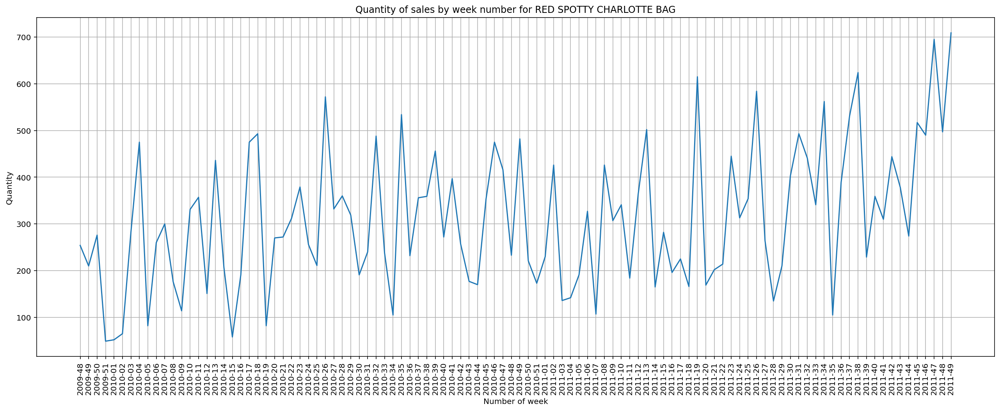

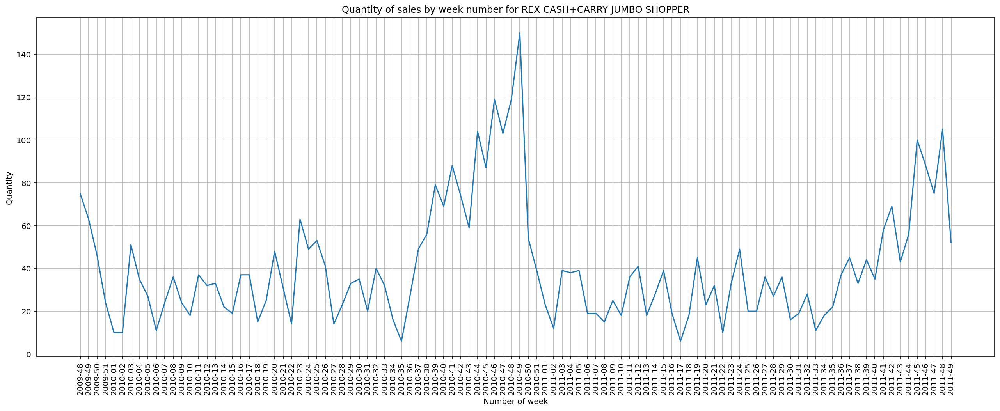

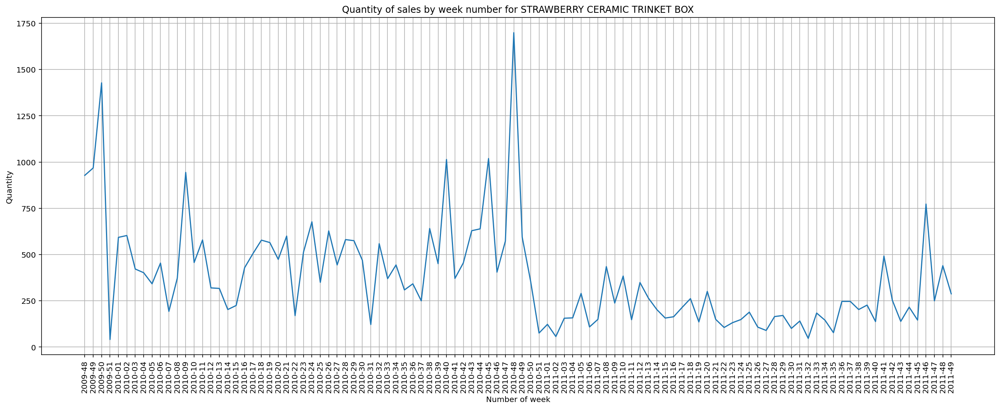

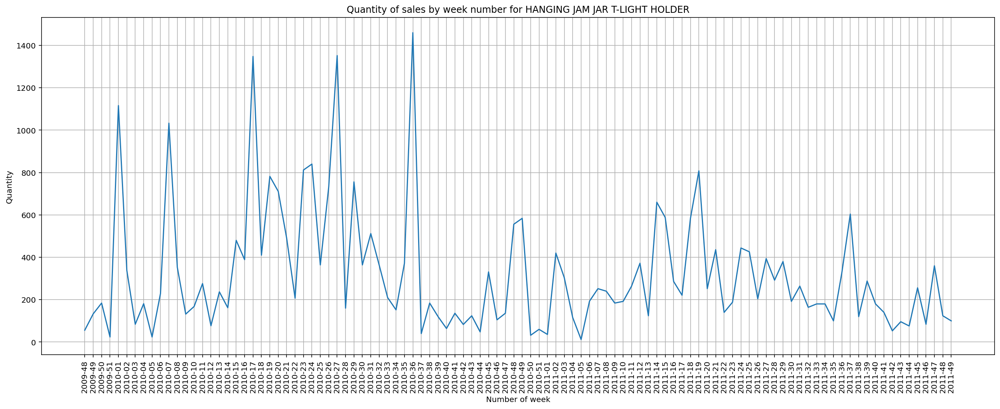

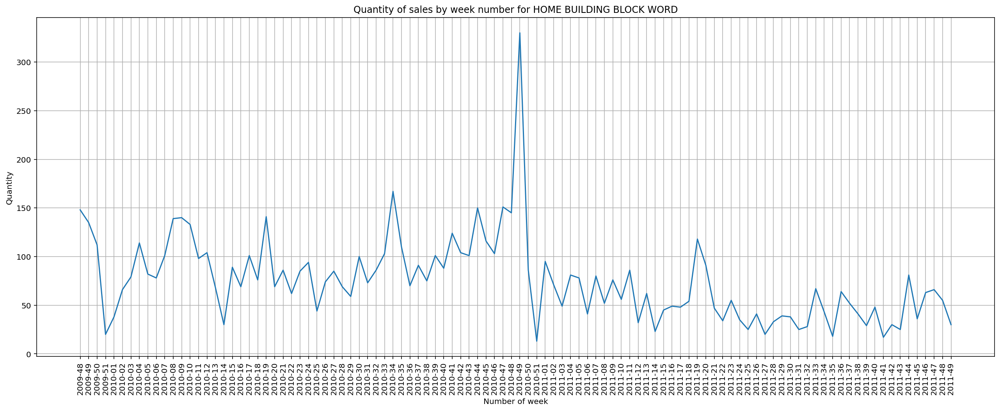

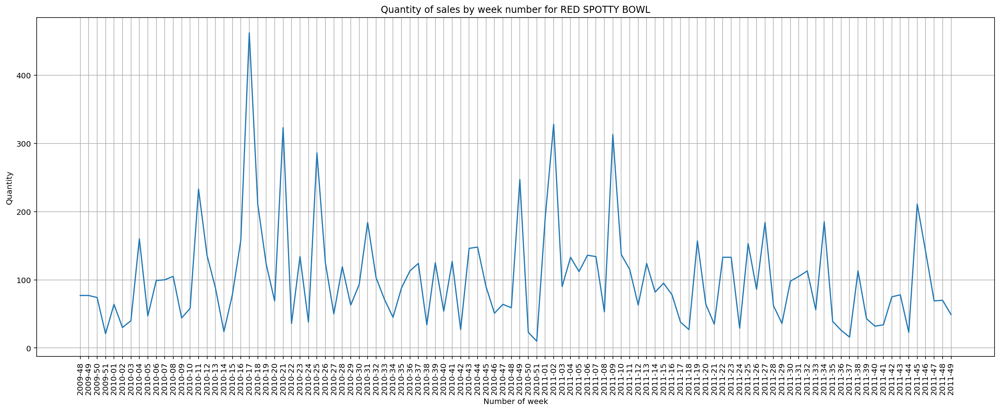

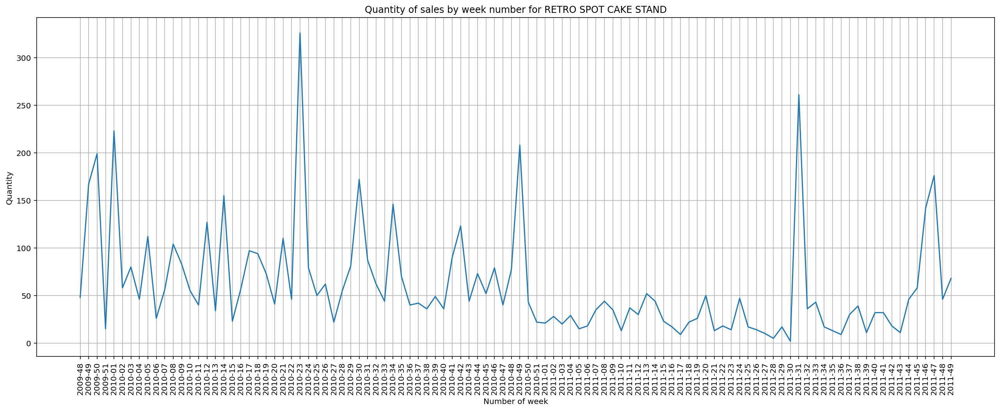

In [0]:
top7_purch = df_week['StockCode'].value_counts()[:7].keys()
for purch in top7_purch:
    x = df_week[df_week['StockCode'] == purch]['week-year']
    y = df_week[df_week['StockCode'] == purch]['Quantity']
    plt.plot(x, y)
    plt.gcf().set_size_inches((22,8))
    plt.xticks(rotation=90)
    plt.grid()
    plt.title('Quantity of sales by week number for {}'.format(stockcode_dict[purch][0]))
    plt.xlabel('Number of week')
    plt.ylabel('Quantity')
    plt.show()

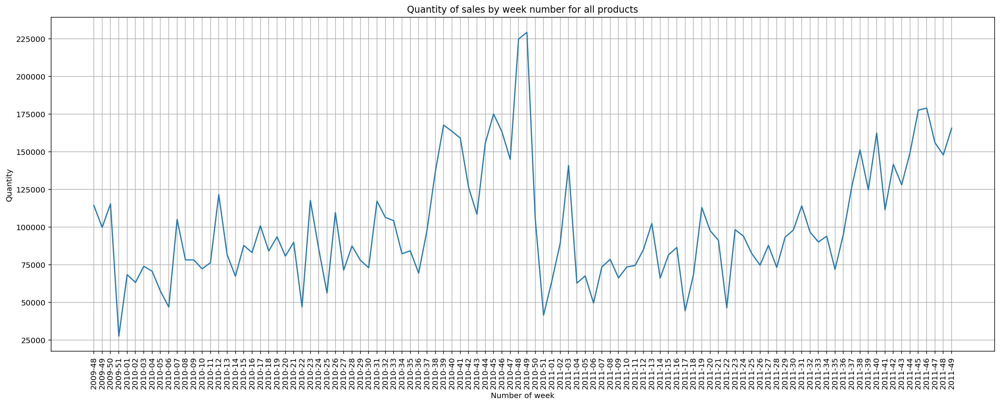

In [0]:
x = df_week.groupby(['week-year'], as_index = False).sum()['week-year']
y = df_week.groupby(['week-year'], as_index = False).sum()['Quantity']
plt.plot(x, y)
plt.gcf().set_size_inches((22,8))
plt.xticks(rotation=90)
plt.grid()
plt.title('Quantity of sales by week number for all products')
plt.xlabel('Number of week')
plt.ylabel('Quantity')
plt.show()

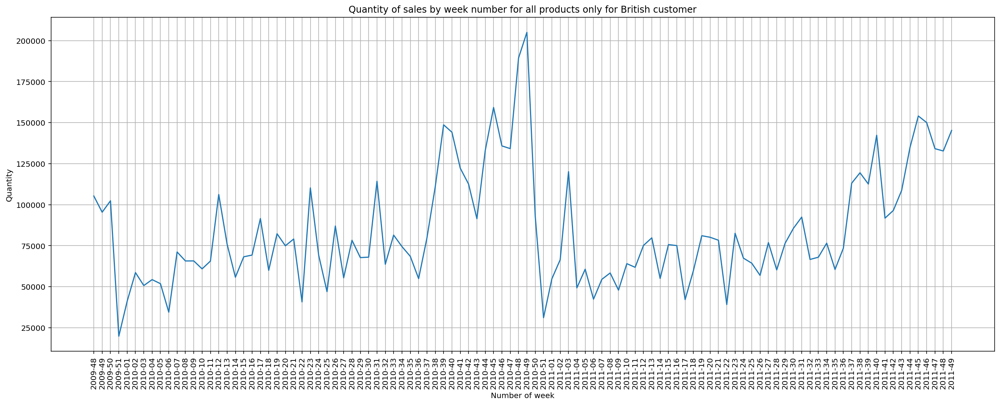

In [0]:
x = df_week_britain.groupby(['week-year'], as_index = False).sum()['week-year']
y = df_week_britain.groupby(['week-year'], as_index = False).sum()['Quantity']
plt.plot(x, y)
plt.gcf().set_size_inches((22,8))
plt.xticks(rotation=90)
plt.grid()
plt.title('Quantity of sales by week number for all products only for British customer')
plt.xlabel('Number of week')
plt.ylabel('Quantity')
plt.show()

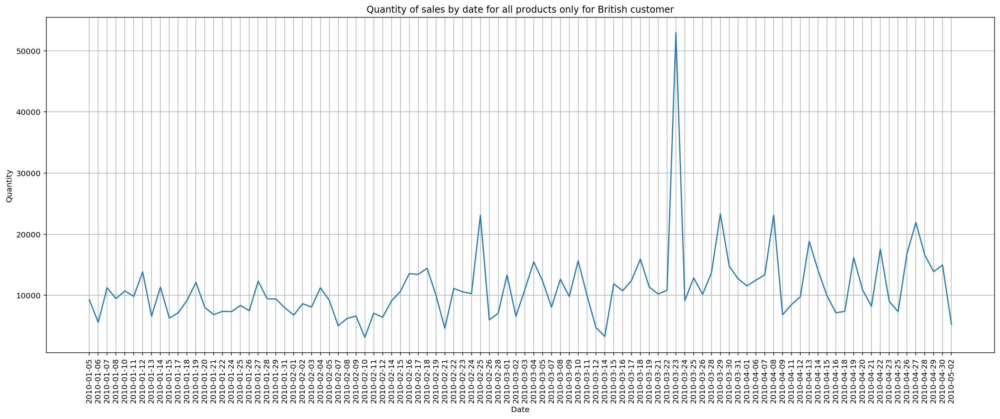

In [0]:
x = df_day_britain.groupby(['year-month-day'], as_index = False).sum()['year-month-day'].iloc[22:120]
y = df_day_britain.groupby(['year-month-day'], as_index = False).sum()['Quantity'].iloc[22:120]
plt.plot(x, y)
plt.gcf().set_size_inches((22,8))
plt.xticks(rotation=90)
plt.grid()
plt.title('Quantity of sales by date for all products only for British customer')
plt.xlabel('Date')
plt.ylabel('Quantity')
plt.show()

**SEASONAL DECOMPOSE**

freq is the cycle length in number of period. 

In [0]:
from statsmodels.tsa.seasonal import seasonal_decompose
from datetime import datetime

In [0]:
df_week_britain_allprod = df_week_britain.groupby(['week-year'], as_index = False).sum()
df_day_britain_allprod = df_day_britain.groupby(['year-month-day'], as_index = False).sum()

Разложение ряда на тренд, сезонность и остатки для еженедельной агрегации

In [0]:

df_week_britain_allprod['Date'] = \
    df_week_britain_allprod['week-year'].apply(lambda x: datetime.strptime(x + '-1', "%Y-%W-%w"))

In [0]:
df_week_britain_allprod.index = df_week_britain_allprod['Date']

In [0]:
df_week_britain_allprod = df_week_britain_allprod.drop(['week-year'], axis = 1)

In [0]:
week_quant_dict = df_week_britain_allprod['Quantity'].to_dict()

Заполним все пропущенные даты 0

In [0]:
def generate_week(start, end): #start = int(201901) end = int(202052)
    start_year = start // 100
    start_week = start % 100
    end_year = end // 100
    end_week = end % 100
    all_weeks = []
    all_weeks.append(str(start))
    while (start_year != end_year) or (start_week != end_week):
        if start_week % 52 == 0:
            start_year += 1
            start_week = 0
        start_week += 1
        if len(str(start_week))==1:
            all_weeks.append(str(start_year) + str(0) + str(start_week))
        else:
            all_weeks.append(str(start_year) + str(start_week))
    return all_weeks

In [0]:
dates_list = generate_week(200948, 201149)

df_all_week = pd.DataFrame({'week-year':dates_list})

In [0]:
df_all_week['Date'] = df_all_week['week-year'].apply(lambda x: datetime.strptime(x + '-1', "%Y%W-%w"))

In [0]:
df_all_week['Quantity'] = df_all_week['Date']
df_all_week['Quantity'] = df_all_week['Quantity'].map(week_quant_dict)
df_all_week1 = df_all_week.copy()
df_all_week0 = df_all_week.copy()
df_all_week1['Quantity'].fillna(1, inplace = True)
df_all_week0['Quantity'].fillna(0, inplace = True)

In [0]:
df_all_week1.index = df_all_week1['Date']
df_all_week0.index = df_all_week0['Date']

In [0]:
df_all_week0_ln = df_all_week0.copy()

In [0]:
df_all_week0_ln['Quantity'] = np.log1p(df_all_week0['Quantity'].to_list())

In [0]:
result0 = seasonal_decompose(df_all_week0['Quantity'], model='additive', freq = 52)

In [0]:
result1 = seasonal_decompose(df_all_week1['Quantity'], model='multiplicative', freq = 52)

почему у тренда появилиcь NAN?

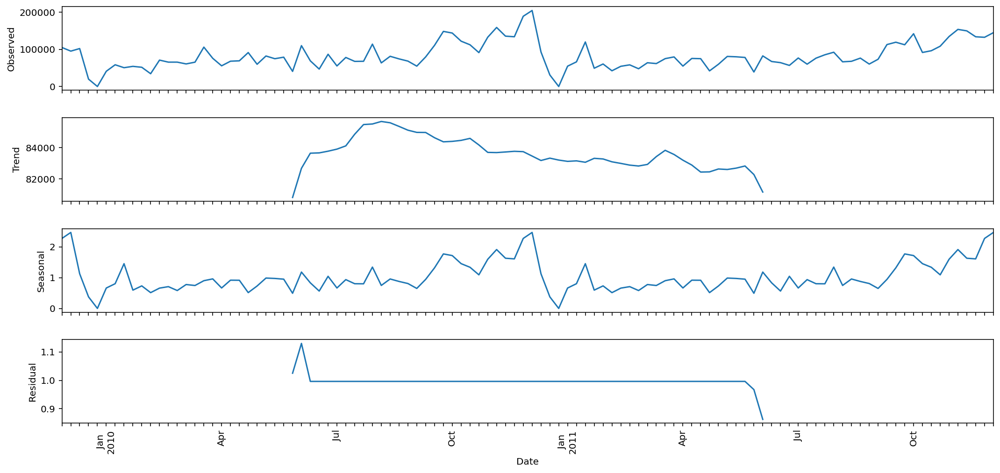

In [0]:
result1.plot()
plt.gcf().set_size_inches((17,8))
plt.xticks(df_all_week['Date'].to_list(), rotation = 90)
plt.show()

In [0]:
result_month1 = seasonal_decompose(df_week_britain_allprod['Quantity'], model='multiplicative', freq = 12)

In [0]:
result_month0 = seasonal_decompose(df_week_britain_allprod['Quantity'], model='additive', freq = 12)

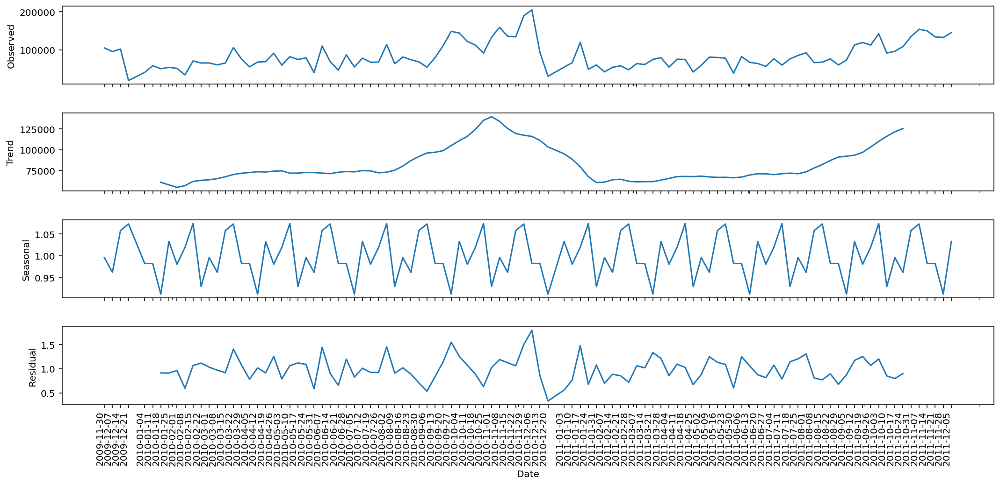

In [0]:
result_month1.plot()
plt.gcf().set_size_inches((17,8))
plt.xticks(df_week_britain_allprod['Date'], rotation = 90)
plt.show()

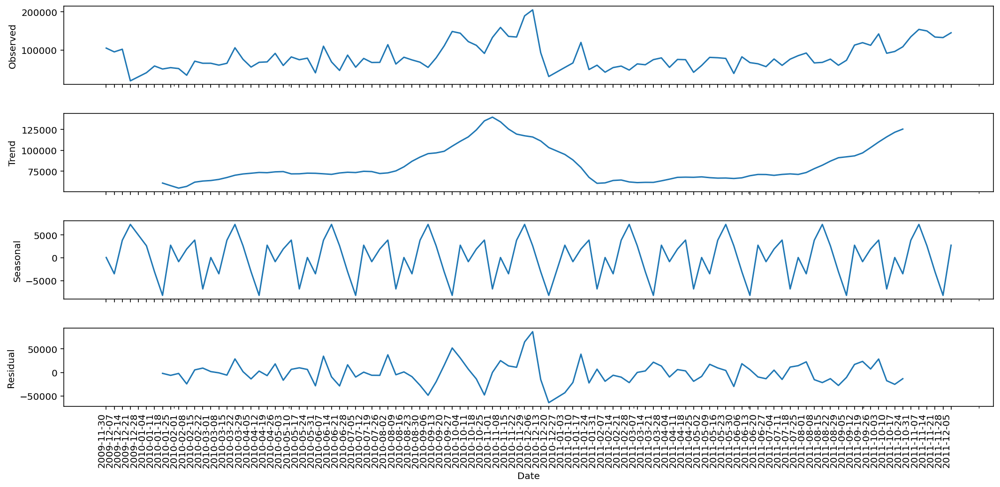

In [0]:
result_month0.plot()
plt.gcf().set_size_inches((17,8))
plt.xticks(df_all_week0['Date'], rotation = 90)
plt.show()

Разложение ряда на тренд, сезонность и остатки для ежедневной агрегации

In [0]:
df_day_britain_allprod['year-month-day'] = \
    pd.to_datetime(df_day_britain_allprod['year-month-day'], format='%Y-%m-%d')

In [0]:
df_day_britain_allprod.index = df_day_britain_allprod['year-month-day']

In [0]:
quant_byday_dict = df_day_britain_allprod['Quantity'].to_dict()

In [0]:
from datetime import timedelta
d_start = df_day_britain_allprod['year-month-day'].min()
d_end = df_day_britain_allprod['year-month-day'].max()
dd = [d_start + timedelta(days=x) for x in range((d_end-d_start).days + 1)]

In [0]:
df_all_days = pd.DataFrame({'year-month-day':dd})

In [0]:
df_all_days['Quantity'] = df_all_days['year-month-day']
df_all_days['Quantity'] = df_all_days['Quantity'].map(quant_byday_dict)
df_all_days.index = df_all_days['year-month-day']
df_all_days0 = df_all_days.copy()
df_all_days1 = df_all_days.copy()
df_all_days1['Quantity'].fillna(1, inplace = True)
df_all_days0['Quantity'].fillna(0, inplace = True)

In [0]:
df_all_days0.head()

,year-month-day,Quantity
year-month-day,,
2009-12-01,2009-12-01,18719.0
2009-12-02,2009-12-02,22892.0
2009-12-03,2009-12-03,43590.0
2009-12-04,2009-12-04,16330.0
2009-12-05,2009-12-05,3764.0


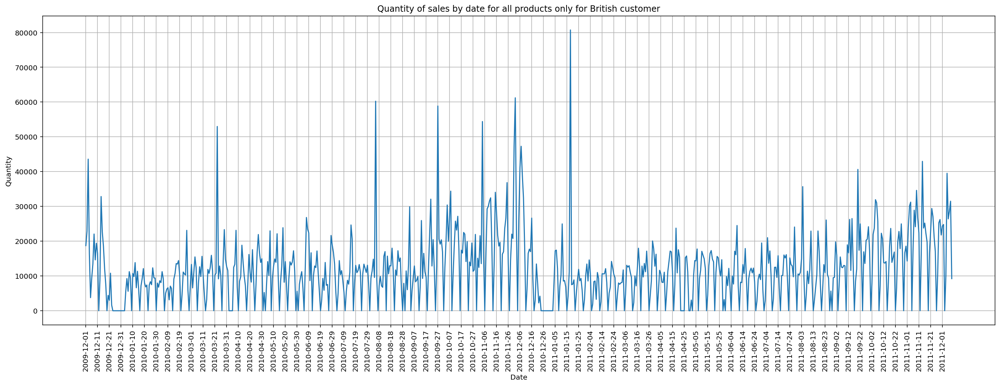

In [0]:
x = df_all_days0['year-month-day']
y = df_all_days0['Quantity']
plt.plot(x, y)
plt.gcf().set_size_inches((24,8))
plt.xticks(x[::10], rotation=90)
plt.grid()
plt.title('Quantity of sales by date for all products only for British customer')
plt.xlabel('Date')
plt.ylabel('Quantity')
plt.show()

In [0]:
df_all_days0_ln = df_all_days0.copy()
df_all_days0_ln['Quantity'] = np.log1p(df_all_days0['Quantity'].to_list())

In [0]:
result_daysln = seasonal_decompose(df_all_days0_ln['Quantity'], model='additive', freq = 90)

In [0]:
result_day_year_alldays = seasonal_decompose(df_all_days1['Quantity'], model='multiplicative', freq = 90)

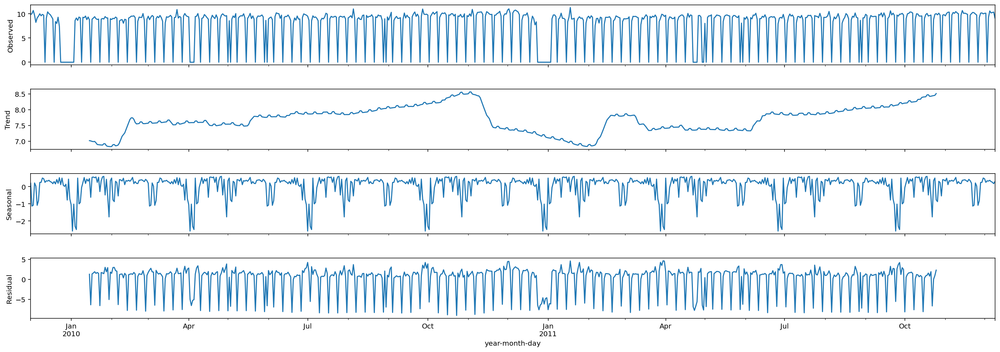

In [0]:
result_daysln.plot()
plt.gcf().set_size_inches((22,8))
#plt.xticks(days_list[::10], rotation = 90)
plt.show()

**Десезонализация**



In [0]:
df_all_days0_ln = df_all_days0_ln.drop(['year-month-day'],axis = 1)

In [0]:
df_all_days0_ln.to_csv('gdrive/My Drive/final_timeseries.csv', index = True)

In [0]:
result_daysln.seasonal.to_csv('gdrive/My Drive/seasonal_coeff.csv', index = True)

In [0]:
df_all_days0 = df_all_days0.drop(['year-month-day'],axis = 1)

In [0]:
df_all_days0.to_csv('gdrive/My Drive/original_timeseries.csv', index = True)

Стики не пишутся, так как раньше это было строчкой, теперь это. datetime ??

In [0]:
days_list = df_all_days1['year-month-day'].dt.strftime('%Y-%m-%d').to_list()

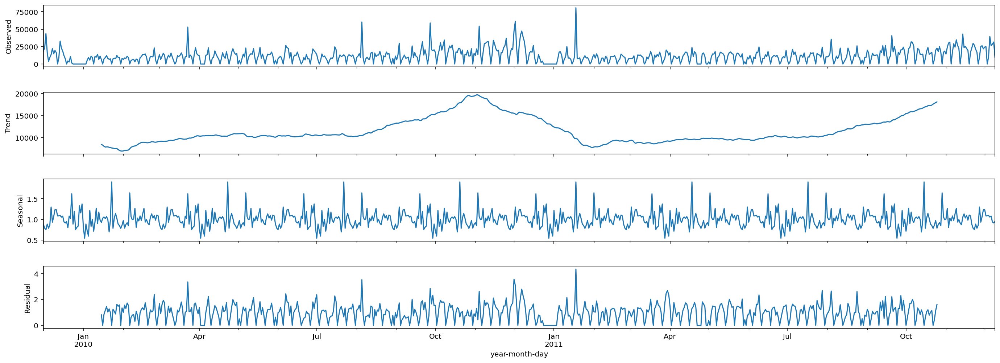

In [0]:
result_day_year_alldays.plot()
plt.gcf().set_size_inches((22,8))
#plt.xticks(days_list[::10], rotation = 90)
plt.show()

In [0]:
result_day_year_alldays = seasonal_decompose(df_all_days1['Quantity'], model='multiplicative', freq = 30)

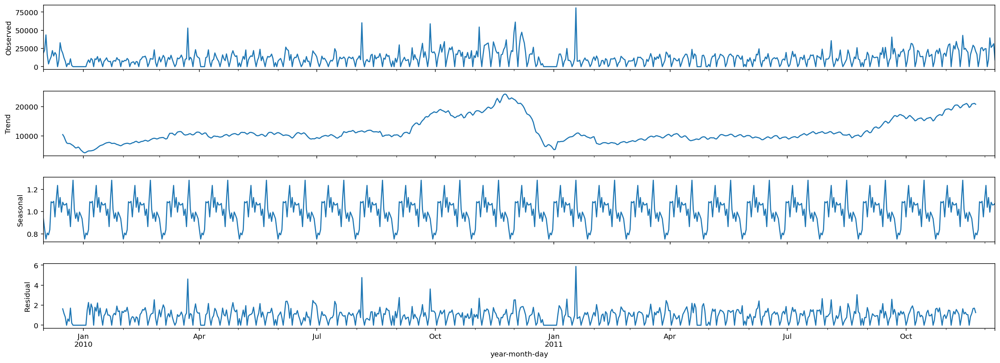

In [0]:
result_day_year_alldays.plot()
plt.gcf().set_size_inches((22,8))
#plt.xticks(days_list[::10], rotation = 90)
plt.show()

In [0]:
result_day_year = seasonal_decompose(df_day_britain_allprod['Quantity'], model='multiplicative', freq = 90)

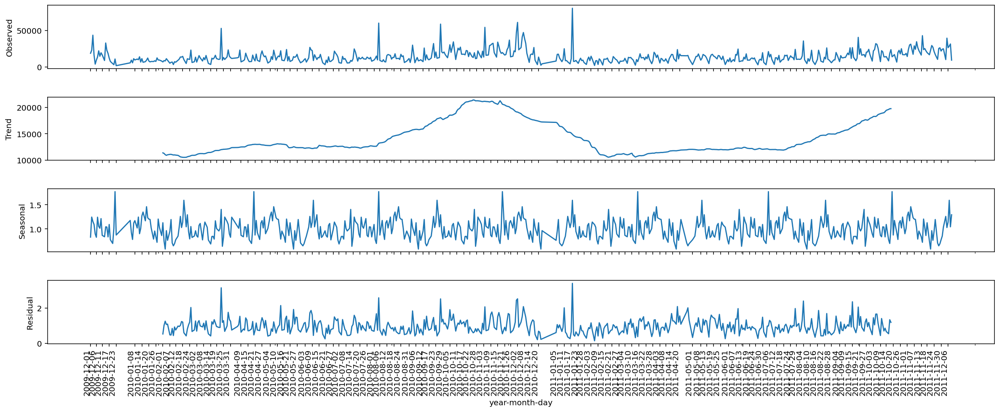

In [0]:
result_day_year.plot()
plt.gcf().set_size_inches((20,8))
plt.xticks(df_day_britain_allprod['year-month-day'].to_list()[::5], rotation = 90)
plt.show()

In [0]:
result_day_year = seasonal_decompose(df_day_britain_allprod['Quantity'], model='multiplicative', freq = 30)

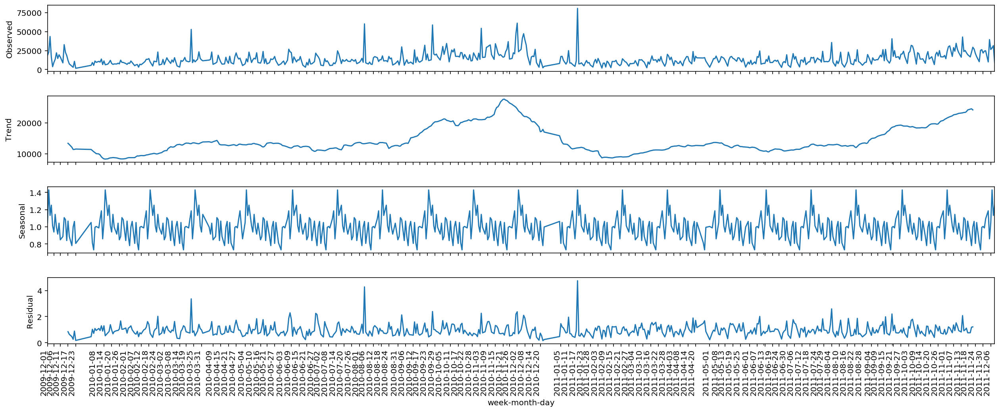

In [0]:
result_day_year.plot()
plt.gcf().set_size_inches((20,8))
plt.xticks(df_day_britain_allprod['year-month-day'].to_list()[::5], rotation = 90)
plt.show()

Кажется что лучше юзать данные по дням

**Экспоненциальное сглаживание Хольта-Уинтерса для данных на ежедневной основе**

In [0]:
def wape(y_pred, y_true):
    res = np.sum(np.abs(y_true - y_pred)) / np.sum(y_true) * 100
    return res

In [0]:
from sklearn.metrics import mean_absolute_error

In [0]:
df_all_days0 = df_all_days0.drop(['year-month-day'], axis = 1)
df_all_days1 = df_all_days1.drop(['year-month-day'], axis = 1)

In [0]:
df_all_days1.shape

(739, 1)

In [0]:
#df_all_days1.index.freq = 'D'
df_all_days0.index.freq = 'D'

WAPE error: 62.85701930755483
MAE error: 10454.651265370067


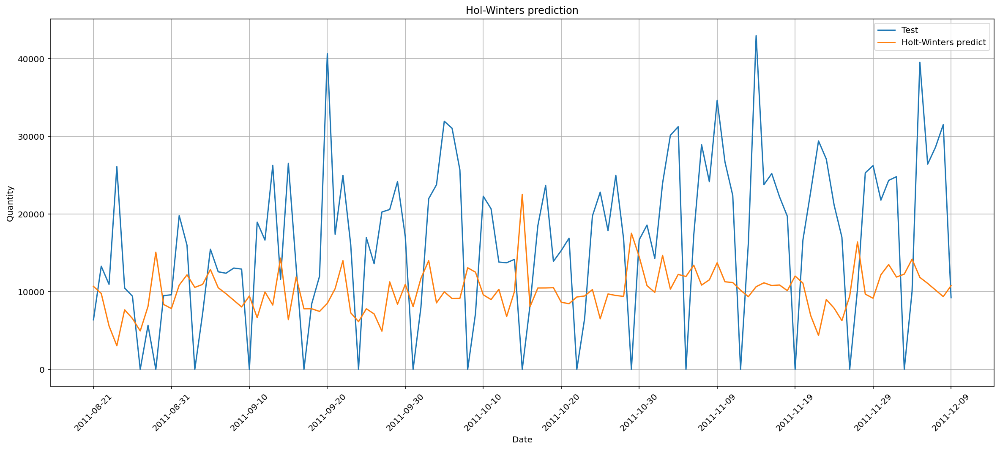

In [0]:
from statsmodels.tsa.holtwinters import ExponentialSmoothing

train, test = df_all_days0.iloc[:628, 0], df_all_days0.iloc[628:, 0]
model = ExponentialSmoothing(train, seasonal='add', trend='add', seasonal_periods=90).fit()
pred = model.predict(start=628, end=738)


print("WAPE error: {}".format(wape(pred, test)))
print("MAE error: {}".format( mean_absolute_error(test, pred)))

#plt.plot(train.index, train, label='Train')
plt.plot(test.index, test, label='Test')
plt.plot(pred.index, pred, label='Holt-Winters predict')
plt.xticks(test.index.to_list()[::10], rotation = 45)
plt.legend(loc='best')
plt.grid()
plt.gcf().set_size_inches((20,8))
plt.title('Hol-Winters prediction')
plt.xlabel('Date')
plt.ylabel('Quantity')
plt.show()

WAPE error: 59.84045026452136
MAE error: 8432.511362778163


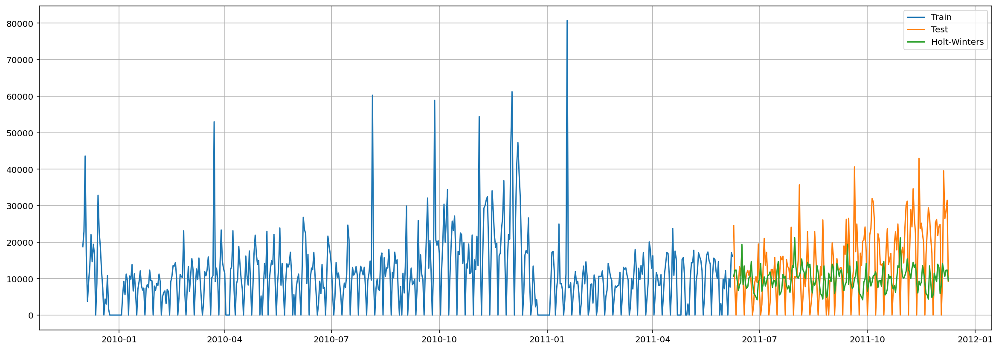

In [0]:
train, test = df_all_days1.iloc[:555, 0], df_all_days1.iloc[555:, 0]
fit1 = ExponentialSmoothing(train, seasonal_periods=90, trend='add', seasonal='add').fit()
pred = fit1.predict(start=555, end=738)

print("WAPE error: {}".format(wape(pred, test)))
print("MAE error: {}".format( mean_absolute_error(test, pred)))

plt.plot(train.index, train, label='Train')
plt.plot(test.index, test, label='Test')
plt.plot(pred.index, pred, label='Holt-Winters')
plt.xticks
plt.legend(loc='best')
plt.grid()
plt.gcf().set_size_inches((20,7))

WAPE error: 58.179373957175315
MAE error: 10568.11331710484


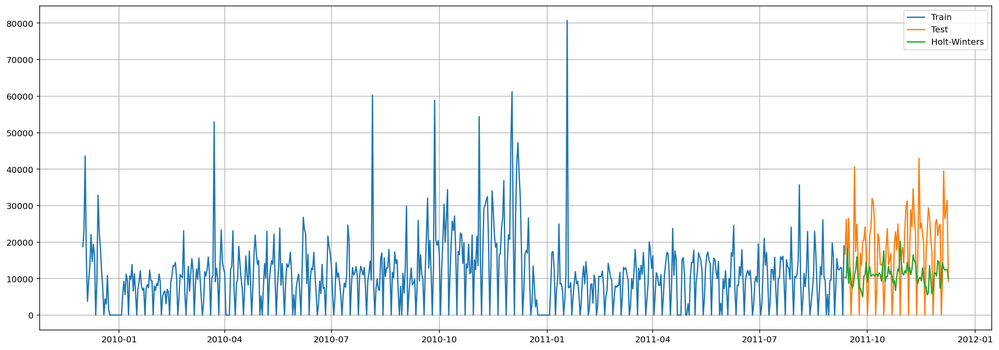

In [0]:
train, test = df_all_days0.iloc[:650, 0], df_all_days0.iloc[650:, 0]
fit1 = ExponentialSmoothing(train, seasonal_periods=90, trend='add', seasonal='add').fit()
pred = fit1.predict(start=650, end=738)

print("WAPE error: {}".format(wape(pred, test)))
print("MAE error: {}".format( mean_absolute_error(test, pred)))

plt.plot(train.index, train, label='Train')
plt.plot(test.index, test, label='Test')
plt.plot(pred.index, pred, label='Holt-Winters')
plt.xticks
plt.legend(loc='best')
plt.grid()
plt.gcf().set_size_inches((20,7))

**Экспоненциальное сглаживание Хольта-Уинтерса для данных на еженедельной основе**

In [0]:
df_all_week0 = df_all_week0.drop(['week-year', 'Date'], axis = 1)
df_all_week1 = df_all_week1.drop(['week-year', 'Date'], axis = 1)

In [0]:
df_all_week1.index.freq = 'W-MON'
df_all_week0.index.freq = 'W-MON'

In [0]:
import numpy as np
import pandas as pd
from scipy.optimize import basinhopping, brute, minimize
from scipy.spatial.distance import sqeuclidean
from scipy.special import inv_boxcox
from scipy.stats import boxcox
from scipy.stats import (
    _distn_infrastructure, rv_continuous, rv_discrete
)

from statsmodels.base.data import PandasData
from statsmodels.base.model import Results
from statsmodels.base.wrapper import (populate_wrapper, union_dicts,
                                      ResultsWrapper)
from statsmodels.tools.validation import (array_like, bool_like, float_like,
                                          string_like, int_like)
from statsmodels.tsa.base.tsa_model import TimeSeriesModel
from statsmodels.tsa.tsatools import freq_to_period
import statsmodels.tsa._exponential_smoothers as smoothers


def _holt_init(x, xi, p, y, l, b):
    """Initialization for the Holt Models"""
    p[xi.astype(np.bool)] = x
    alpha, beta, _, l0, b0, phi = p[:6]
    alphac = 1 - alpha
    betac = 1 - beta
    y_alpha = alpha * y
    l[:] = 0
    b[:] = 0
    l[0] = l0
    b[0] = b0
    return alpha, beta, phi, alphac, betac, y_alpha


def _holt__(x, xi, p, y, l, b, s, m, n, max_seen):
    """
    Simple Exponential Smoothing
    Minimization Function
    (,)
    """
    alpha, beta, phi, alphac, betac, y_alpha = _holt_init(x, xi, p, y, l, b)
    for i in range(1, n):
        l[i] = (y_alpha[i - 1]) + (alphac * (l[i - 1]))
    return sqeuclidean(l, y)


def _holt_mul_dam(x, xi, p, y, l, b, s, m, n, max_seen):
    """
    Multiplicative and Multiplicative Damped
    Minimization Function
    (M,) & (Md,)
    """
    alpha, beta, phi, alphac, betac, y_alpha = _holt_init(x, xi, p, y, l, b)
    if alpha == 0.0:
        return max_seen
    if beta > alpha:
        return max_seen
    for i in range(1, n):
        l[i] = (y_alpha[i - 1]) + (alphac * (l[i - 1] * b[i - 1]**phi))
        b[i] = (beta * (l[i] / l[i - 1])) + (betac * b[i - 1]**phi)
    return sqeuclidean(l * b**phi, y)


def _holt_add_dam(x, xi, p, y, l, b, s, m, n, max_seen):
    """
    Additive and Additive Damped
    Minimization Function
    (A,) & (Ad,)
    """
    alpha, beta, phi, alphac, betac, y_alpha = _holt_init(x, xi, p, y, l, b)
    if alpha == 0.0:
        return max_seen
    if beta > alpha:
        return max_seen
    for i in range(1, n):
        l[i] = (y_alpha[i - 1]) + (alphac * (l[i - 1] + phi * b[i - 1]))
        b[i] = (beta * (l[i] - l[i - 1])) + (betac * phi * b[i - 1])
    return sqeuclidean(l + phi * b, y)


def _holt_win_init(x, xi, p, y, l, b, s, m):
    """Initialization for the Holt Winters Seasonal Models"""
    p[xi.astype(np.bool)] = x
    alpha, beta, gamma, l0, b0, phi = p[:6]
    s0 = p[6:]
    alphac = 1 - alpha
    betac = 1 - beta
    gammac = 1 - gamma
    y_alpha = alpha * y
    y_gamma = gamma * y
    l[:] = 0
    b[:] = 0
    s[:] = 0
    l[0] = l0
    b[0] = b0
    s[:m] = s0
    return alpha, beta, gamma, phi, alphac, betac, gammac, y_alpha, y_gamma


def _holt_win__mul(x, xi, p, y, l, b, s, m, n, max_seen):
    """
    Multiplicative Seasonal
    Minimization Function
    (,M)
    """
    alpha, beta, gamma, phi, alphac, betac, gammac, y_alpha, y_gamma = _holt_win_init(
        x, xi, p, y, l, b, s, m)
    if alpha == 0.0:
        return max_seen
    if gamma > 1 - alpha:
        return max_seen
    for i in range(1, n):
        l[i] = (y_alpha[i - 1] / s[i - 1]) + (alphac * (l[i - 1]))
        s[i + m - 1] = (y_gamma[i - 1] / (l[i - 1])) + (gammac * s[i - 1])
    return sqeuclidean(l * s[:-(m - 1)], y)


def _holt_win__add(x, xi, p, y, l, b, s, m, n, max_seen):
    """
    Additive Seasonal
    Minimization Function
    (,A)
    """
    alpha, beta, gamma, phi, alphac, betac, gammac, y_alpha, y_gamma = _holt_win_init(
        x, xi, p, y, l, b, s, m)
    if alpha == 0.0:
        return max_seen
    if gamma > 1 - alpha:
        return max_seen
    for i in range(1, n):
        l[i] = (y_alpha[i - 1]) - (alpha * s[i - 1]) + (alphac * (l[i - 1]))
        s[i + m - 1] = y_gamma[i - 1] - (gamma * (l[i - 1])) + (gammac * s[i - 1])
    return sqeuclidean(l + s[:-(m - 1)], y)


def _holt_win_add_mul_dam(x, xi, p, y, l, b, s, m, n, max_seen):
    """
    Additive and Additive Damped with Multiplicative Seasonal
    Minimization Function
    (A,M) & (Ad,M)
    """
    alpha, beta, gamma, phi, alphac, betac, gammac, y_alpha, y_gamma = _holt_win_init(
        x, xi, p, y, l, b, s, m)
    if alpha * beta == 0.0:
        return max_seen
    if beta > alpha or gamma > 1 - alpha:
        return max_seen
    for i in range(1, n):
        l[i] = (y_alpha[i - 1] / s[i - 1]) + \
               (alphac * (l[i - 1] + phi * b[i - 1]))
        b[i] = (beta * (l[i] - l[i - 1])) + (betac * phi * b[i - 1])
        s[i + m - 1] = (y_gamma[i - 1] / (l[i - 1] + phi *
                                          b[i - 1])) + (gammac * s[i - 1])
    return sqeuclidean((l + phi * b) * s[:-(m - 1)], y)


def _holt_win_mul_mul_dam(x, xi, p, y, l, b, s, m, n, max_seen):
    """
    Multiplicative and Multiplicative Damped with Multiplicative Seasonal
    Minimization Function
    (M,M) & (Md,M)
    """
    alpha, beta, gamma, phi, alphac, betac, gammac, y_alpha, y_gamma = _holt_win_init(
        x, xi, p, y, l, b, s, m)
    if alpha * beta == 0.0:
        return max_seen
    if beta > alpha or gamma > 1 - alpha:
        return max_seen
    for i in range(1, n):
        l[i] = (y_alpha[i - 1] / s[i - 1]) + \
               (alphac * (l[i - 1] * b[i - 1]**phi))
        b[i] = (beta * (l[i] / l[i - 1])) + (betac * b[i - 1]**phi)
        s[i + m - 1] = (y_gamma[i - 1] / (l[i - 1] *
                                          b[i - 1]**phi)) + (gammac * s[i - 1])
    return sqeuclidean((l * b**phi) * s[:-(m - 1)], y)


def _holt_win_add_add_dam(x, xi, p, y, l, b, s, m, n, max_seen):
    """
    Additive and Additive Damped with Additive Seasonal
    Minimization Function
    (A,A) & (Ad,A)
    """
    alpha, beta, gamma, phi, alphac, betac, gammac, y_alpha, y_gamma = _holt_win_init(
        x, xi, p, y, l, b, s, m)
    if alpha * beta == 0.0:
        return max_seen
    if beta > alpha or gamma > 1 - alpha:
        return max_seen
    for i in range(1, n):
        l[i] = (y_alpha[i - 1]) - (alpha * s[i - 1]) + \
               (alphac * (l[i - 1] + phi * b[i - 1]))
        b[i] = (beta * (l[i] - l[i - 1])) + (betac * phi * b[i - 1])
        s[i + m - 1] = y_gamma[i - 1] - (gamma * (l[i - 1] + phi * b[i - 1])) + (gammac * s[i - 1])
    return sqeuclidean((l + phi * b) + s[:-(m - 1)], y)


def _holt_win_mul_add_dam(x, xi, p, y, l, b, s, m, n, max_seen):
    """
    Multiplicative and Multiplicative Damped with Additive Seasonal
    Minimization Function
    (M,A) & (M,Ad)
    """
    alpha, beta, gamma, phi, alphac, betac, gammac, y_alpha, y_gamma = _holt_win_init(
        x, xi, p, y, l, b, s, m)
    if alpha * beta == 0.0:
        return max_seen
    if beta > alpha or gamma > 1 - alpha:
        return max_seen
    for i in range(1, n):
        l[i] = (y_alpha[i - 1]) - (alpha * s[i - 1]) + \
               (alphac * (l[i - 1] * b[i - 1]**phi))
        b[i] = (beta * (l[i] / l[i - 1])) + (betac * b[i - 1]**phi)
        s[i + m - 1] = y_gamma[i - 1] - \
            (gamma * (l[i - 1] * b[i - 1]**phi)) + (gammac * s[i - 1])
    return sqeuclidean((l * phi * b) + s[:-(m - 1)], y)


SMOOTHERS = {('mul', 'add'): smoothers._holt_win_add_mul_dam,
             ('mul', 'mul'): smoothers._holt_win_mul_mul_dam,
             ('mul', None): smoothers._holt_win__mul,
             ('add', 'add'): smoothers._holt_win_add_add_dam,
             ('add', 'mul'): smoothers._holt_win_mul_add_dam,
             ('add', None): smoothers._holt_win__add,
             (None, 'add'): smoothers._holt_add_dam,
             (None, 'mul'): smoothers._holt_mul_dam,
             (None, None): smoothers._holt__}

PY_SMOOTHERS = {('mul', 'add'): _holt_win_add_mul_dam,
                ('mul', 'mul'): _holt_win_mul_mul_dam,
                ('mul', None): _holt_win__mul,
                ('add', 'add'): _holt_win_add_add_dam,
                ('add', 'mul'): _holt_win_mul_add_dam,
                ('add', None): _holt_win__add,
                (None, 'add'): _holt_add_dam,
                (None, 'mul'): _holt_mul_dam,
                (None, None): _holt__}


class HoltWintersResults(Results):
    """
    Holt Winter's Exponential Smoothing Results

    Parameters
    ----------
    model : ExponentialSmoothing instance
        The fitted model instance
    params : dict
        All the parameters for the Exponential Smoothing model.

    Attributes
    ----------
    params: dict
        All the parameters for the Exponential Smoothing model.
    params_formatted: pd.DataFrame
        DataFrame containing all parameters, their short names and a flag
        indicating whether the parameter's value was optimized to fit the data.
    fittedfcast: ndarray
        An array of both the fitted values and forecast values.
    fittedvalues: ndarray
        An array of the fitted values. Fitted by the Exponential Smoothing
        model.
    fcastvalues: ndarray
        An array of the forecast values forecast by the Exponential Smoothing
        model.
    sse: float
        The sum of squared errors
    level: ndarray
        An array of the levels values that make up the fitted values.
    slope: ndarray
        An array of the slope values that make up the fitted values.
    season: ndarray
        An array of the seasonal values that make up the fitted values.
    aic: float
        The Akaike information criterion.
    bic: float
        The Bayesian information criterion.
    aicc: float
        AIC with a correction for finite sample sizes.
    resid: ndarray
        An array of the residuals of the fittedvalues and actual values.
    k: int
        the k parameter used to remove the bias in AIC, BIC etc.
    optimized: bool
        Flag indicating whether the model parameters were optimized to fit
        the data.
    mle_retvals:  {None, scipy.optimize.optimize.OptimizeResult}
        Optimization results if the parameters were optimized to fit the data.
    """

    def __init__(self, model, params, **kwargs):
        self.data = model.data
        super(HoltWintersResults, self).__init__(model, params, **kwargs)

    def predict(self, start=None, end=None):
        """
        In-sample prediction and out-of-sample forecasting

        Parameters
        ----------
        start : int, str, or datetime, optional
            Zero-indexed observation number at which to start forecasting, ie.,
            the first forecast is start. Can also be a date string to
            parse or a datetime type. Default is the the zeroth observation.
        end : int, str, or datetime, optional
            Zero-indexed observation number at which to end forecasting, ie.,
            the first forecast is start. Can also be a date string to
            parse or a datetime type. However, if the dates index does not
            have a fixed frequency, end must be an integer index if you
            want out of sample prediction. Default is the last observation in
            the sample.

        Returns
        -------
        forecast : ndarray
            Array of out of sample forecasts.
        """
        return self.model.predict(self.params, start, end)


    def forecast(self, steps=1):
        """
        Out-of-sample forecasts

        Parameters
        ----------
        steps : int
            The number of out of sample forecasts from the end of the
            sample.

        Returns
        -------
        forecast : ndarray
            Array of out of sample forecasts
        """
        try:
            freq = getattr(self.model._index, 'freq', 1)
            start = self.model._index[-1] + freq
            end = self.model._index[-1] + steps * freq
            return self.model.predict(self.params, start=start, end=end)
        except (AttributeError, ValueError):
            # May occur when the index does not have a freq
            return self.model._predict(h=steps, **self.params).fcastvalues


    def summary(self):
        """
        Summarize the fitted Model

        Returns
        -------
        smry : Summary instance
            This holds the summary table and text, which can be printed or
            converted to various output formats.

        See Also
        --------
        statsmodels.iolib.summary.Summary
        """
        from statsmodels.iolib.summary import Summary
        from statsmodels.iolib.table import SimpleTable
        model = self.model
        title = model.__class__.__name__ + ' Model Results'

        dep_variable = 'endog'
        if isinstance(self.model.endog, pd.DataFrame):
            dep_variable = self.model.endog.columns[0]
        elif isinstance(self.model.endog, pd.Series):
            dep_variable = self.model.endog.name
        seasonal_periods = None if self.model.seasonal is None else self.model.seasonal_periods
        lookup = {'add': 'Additive', 'additive': 'Additive',
                  'mul': 'Multiplicative', 'multiplicative': 'Multiplicative', None: 'None'}
        transform = self.params['use_boxcox']
        box_cox_transform = True if transform else False
        box_cox_coeff = transform if isinstance(transform, str) else self.params['lamda']
        if isinstance(box_cox_coeff, float):
            box_cox_coeff = '{:>10.5f}'.format(box_cox_coeff)
        top_left = [('Dep. Variable:', [dep_variable]),
                    ('Model:', [model.__class__.__name__]),
                    #('Optimized:', [str(np.any(self.optimized))]),
                    ('Trend:', [lookup[self.model.trend]]),
                    ('Seasonal:', [lookup[self.model.seasonal]]),
                    ('Seasonal Periods:', [str(seasonal_periods)]),
                    ('Box-Cox:', [str(box_cox_transform)]),
                    ('Box-Cox Coeff.:', [str(box_cox_coeff)])]

        top_right = [
            ('No. Observations:', [str(len(self.model.endog))]),
            ('SSE', ['{:5.3f}'.format(self.sse)]),
            ('AIC', ['{:5.3f}'.format(self.aic)]),
            ('BIC', ['{:5.3f}'.format(self.bic)]),
            ('AICC', ['{:5.3f}'.format(self.aicc)]),
            ('Date:', None),
            ('Time:', None)]

        smry = Summary()
        smry.add_table_2cols(self, gleft=top_left, gright=top_right,
                             title=title)
        formatted = self.params_formatted  # type: pd.DataFrame

        def _fmt(x):
            abs_x = np.abs(x)
            scale = 1
            if abs_x != 0:
                scale = int(np.log10(abs_x))
            if scale > 4 or scale < -3:
                return '{:>20.5g}'.format(x)
            dec = min(7 - scale, 7)
            fmt = '{{:>20.{0}f}}'.format(dec)
            return fmt.format(x)

        tab = []
        for _, vals in formatted.iterrows():
            tab.append([_fmt(vals.iloc[1]),
                        '{0:>20}'.format(vals.iloc[0]),
                        '{0:>20}'.format(str(bool(vals.iloc[2])))])
        params_table = SimpleTable(tab, headers=['coeff', 'code', 'optimized'],
                                   title="",
                                   stubs=list(formatted.index))

        smry.tables.append(params_table)

        return smry


    def simulate(
        self,
        nsimulations,
        anchor=None,
        repetitions=1,
        error="add",
        random_errors=None,
        random_state=None,
    ):
        r"""
        Random simulations using the state space formulation.

        Parameters
        ----------
        nsimulations : int
            The number of simulation steps.
        anchor : int, str, or datetime, optional
            First period for simulation. The simulation will be conditional on
            all existing datapoints prior to the `anchor`.  Type depends on the
            index of the given `endog` in the model. Two special cases are the
            strings 'start' and 'end'. `start` refers to beginning the
            simulation at the first period of the sample, and `end` refers to
            beginning the simulation at the first period after the sample.
            Integer values can run from 0 to `nobs`, or can be negative to
            apply negative indexing. Finally, if a date/time index was provided
            to the model, then this argument can be a date string to parse or a
            datetime type. Default is 'end'.
        repetitions : int, optional
            Number of simulated paths to generate. Default is 1 simulated path.
        error : {"add", "mul", "additive", "multiplicative"}, optional
            Error model for state space formulation. Default is ``"add"``.
        random_errors : optional
            Specifies how the random errors should be obtained. Can be one of
            the following:

            * ``None``: Random normally distributed values with variance
              estimated from the fit errors drawn from numpy's standard
              RNG (can be seeded with the `random_state` argument). This is the
              default option.
            * A distribution function from ``scipy.stats``, e.g.
              ``scipy.stats.norm``: Fits the distribution function to the fit
              errors and draws from the fitted distribution.
              Note the difference between ``scipy.stats.norm`` and
              ``scipy.stats.norm()``, the latter one is a frozen distribution
              function.
            * A frozen distribution function from ``scipy.stats``, e.g.
              ``scipy.stats.norm(scale=2)``: Draws from the frozen distribution
              function.
            * A ``np.ndarray`` with shape (`nsimulations`, `repetitions`): Uses
              the given values as random errors.
            * ``"bootstrap"``: Samples the random errors from the fit errors.

        random_state : int or np.random.RandomState, optional
            A seed for the random number generator or a
            ``np.random.RandomState`` object. Only used if `random_errors` is
            ``None``. Default is ``None``.

        Returns
        -------
        sim : pd.Series, pd.DataFrame or np.ndarray
            An ``np.ndarray``, ``pd.Series``, or ``pd.DataFrame`` of simulated
            values.
            If the original data was a ``pd.Series`` or ``pd.DataFrame``, `sim`
            will be a ``pd.Series`` if `repetitions` is 1, and a
            ``pd.DataFrame`` of shape (`nsimulations`, `repetitions`) else.
            Otherwise, if `repetitions` is 1, a ``np.ndarray`` of shape
            (`nsimulations`,) is returned, and if `repetitions` is not 1 a
            ``np.ndarray`` of shape (`nsimulations`, `repetitions`) is
            returned.

        Notes
        -----
        The simulation is based on the state space model of the Holt-Winter's
        methods. The state space model assumes that the true value at time
        :math:`t` is randomly distributed around the prediction value.
        If using the additive error model, this means:

        .. math::

            y_t &= \hat{y}_{t|t-1} + e_t\\
            e_t &\sim \mathcal{N}(0, \sigma^2)

        Using the multiplicative error model:

        .. math::

            y_t &= \hat{y}_{t|t-1} \cdot (1 + e_t)\\
            e_t &\sim \mathcal{N}(0, \sigma^2)

        Inserting these equations into the smoothing equation formulation leads
        to the state space equations. The notation used here follows
        [1]_.

        Additionally,

        .. math::

           B_t &= b_{t-1} \circ_d \phi\\
           L_t &= l_{t-1} \circ_b B_t\\
           S_t &= s_{t-m}\\
           Y_t &= L_t \circ_s S_t,

        where :math:`\circ_d` is the operation linking trend and damping
        parameter (multiplication if the trend is additive, power if the trend
        is multiplicative), :math:`\circ_b` is the operation linking level and
        trend (addition if the trend is additive, multiplication if the trend
        is multiplicative), and :math:`\circ_s` is the operation linking
        seasonality to the rest.

        The state space equations can then be formulated as

        .. math::

           y_t &= Y_t + \eta \cdot e_t\\
           l_t &= L_t + \alpha \cdot (M_e \cdot L_t + \kappa_l) \cdot e_t\\
           b_t &= B_t + \beta \cdot (M_e \cdot B_t + \kappa_b) \cdot e_t\\
           s_t &= S_t + \gamma \cdot (M_e \cdot S_t + \kappa_s) \cdot e_t\\

        with

        .. math::

           \eta &= \begin{cases}
                       Y_t\quad\text{if error is multiplicative}\\
                       1\quad\text{else}
                   \end{cases}\\
           M_e &= \begin{cases}
                       1\quad\text{if error is multiplicative}\\
                       0\quad\text{else}
                   \end{cases}\\

        and, when using the additve error model,

        .. math::

           \kappa_l &= \begin{cases}
                       \frac{1}{S_t}\quad
                       \text{if seasonality is multiplicative}\\
                       1\quad\text{else}
                   \end{cases}\\
           \kappa_b &= \begin{cases}
                       \frac{\kappa_l}{l_{t-1}}\quad
                       \text{if trend is multiplicative}\\
                       \kappa_l\quad\text{else}
                   \end{cases}\\
           \kappa_s &= \begin{cases}
                       \frac{1}{L_t}\quad\text{if seasonality is multiplicative}\\
                       1\quad\text{else}
                   \end{cases}

        When using the multiplicative error model

        .. math::

           \kappa_l &= \begin{cases}
                       0\quad
                       \text{if seasonality is multiplicative}\\
                       S_t\quad\text{else}
                   \end{cases}\\
           \kappa_b &= \begin{cases}
                       \frac{\kappa_l}{l_{t-1}}\quad
                       \text{if trend is multiplicative}\\
                       \kappa_l + l_{t-1}\quad\text{else}
                   \end{cases}\\
           \kappa_s &= \begin{cases}
                       0\quad\text{if seasonality is multiplicative}\\
                       L_t\quad\text{else}
                   \end{cases}

        References
        ----------
        .. [1] Hyndman, R.J., & Athanasopoulos, G. (2018) *Forecasting:
           principles and practice*, 2nd edition, OTexts: Melbourne,
           Australia. OTexts.com/fpp2. Accessed on February 28th 2020.
        """

        # check inputs
        if error in ["additive", "multiplicative"]:
            error = {"additive": "add", "multiplicative": "mul"}[error]
        if error not in ["add", "mul"]:
            raise ValueError("error must be 'add' or 'mul'!")

        # Get the starting location
        if anchor is None or anchor == "end":
            start_idx = self.model.nobs
        elif anchor == "start":
            start_idx = 0
        else:
            start_idx, _, _ = self.model._get_index_loc(anchor)
            if isinstance(start_idx, slice):
                start_idx = start_idx.start
        if start_idx < 0:
            start_idx += self.model.nobs
        if start_idx > self.model.nobs:
            raise ValueError("Cannot anchor simulation outside of the sample.")

        # get Holt-Winters settings and parameters
        trend = self.model.trend
        damped = self.model.damped
        seasonal = self.model.seasonal
        use_boxcox = self.params["use_boxcox"]
        lamda = self.params["lamda"]
        alpha = self.params["smoothing_level"]
        beta = self.params["smoothing_slope"]
        gamma = self.params["smoothing_seasonal"]
        phi = self.params["damping_slope"]
        # if model has no seasonal component, use 1 as period length
        m = max(self.model.seasonal_periods, 1)
        n_params = (
            2
            + 2 * self.model.trending
            + (m + 1) * self.model.seasoning
            + damped
        )
        mul_seasonal = seasonal == "mul"
        mul_trend = trend == "mul"
        mul_error = error == "mul"

        # define trend, damping and seasonality operations
        if mul_trend:
            op_b = np.multiply
            op_d = np.power
            neutral_b = 1
        else:
            op_b = np.add
            op_d = np.multiply
            neutral_b = 0
        if mul_seasonal:
            op_s = np.multiply
            neutral_s = 1
        else:
            op_s = np.add
            neutral_s = 0

        # set initial values
        if use_boxcox:
            level = self.model._untransformed_level
            slope = self.model._untransformed_slope
            season = self.model._untransformed_season
        else:
            level = self.level
            slope = self.slope
            season = self.season
        # (notation as in https://otexts.com/fpp2/ets.html)
        y = np.empty((nsimulations, repetitions))
        # lvl instead of l because of E741
        lvl = np.empty((nsimulations + 1, repetitions))
        b = np.empty((nsimulations + 1, repetitions))
        s = np.empty((nsimulations + m, repetitions))
        # the following uses python's index wrapping
        if start_idx == 0:
            lvl[-1, :] = self.params["initial_level"]
            b[-1, :] = self.params["initial_slope"]
        else:
            lvl[-1, :] = level[start_idx - 1]
            b[-1, :] = slope[start_idx - 1]
        if 0 <= start_idx and start_idx <= m:
            initial_seasons = self.params["initial_seasons"]
            _s = np.concatenate(
                (initial_seasons[start_idx:], season[:start_idx],)
            )
            s[-m:, :] = np.tile(_s, (repetitions, 1)).T
        else:
            s[-m:, :] = np.tile(
                season[start_idx - m : start_idx], (repetitions, 1),
            ).T

        # set neutral values for unused features
        if trend is None:
            b[:, :] = neutral_b
            phi = 1
            beta = 0
        if seasonal is None:
            s[:, :] = neutral_s
            gamma = 0
        if not damped:
            phi = 1

        # calculate residuals for error covariance estimation
        if use_boxcox:
            fitted = boxcox(self.fittedvalues, lamda)
        else:
            fitted = self.fittedvalues
        if error == "add":
            resid = self.model._y - fitted
        else:
            resid = (self.model._y - fitted) / fitted
        sigma = np.sqrt(np.sum(resid ** 2) / (len(resid) - n_params))

        # get random error eps
        if isinstance(random_errors, np.ndarray):
            if random_errors.shape != (nsimulations, repetitions):
                raise ValueError(
                    "If random is an ndarray, it must have shape "
                    "(nsimulations, repetitions)!"
                )
            eps = random_errors
        elif random_errors == "bootstrap":
            eps = np.random.choice(
                resid, size=(nsimulations, repetitions), replace=True
            )
        elif random_errors is None:
            if random_state is None:
                eps = np.random.randn(nsimulations, repetitions) * sigma
            elif isinstance(random_state, int):
                rng = np.random.RandomState(random_state)
                eps = rng.randn(nsimulations, repetitions) * sigma
            elif isinstance(random_state, np.random.RandomState):
                eps = random_state.randn(nsimulations, repetitions) * sigma
            else:
                raise ValueError(
                    "Argument random_state must be None, an integer, "
                    "or an instance of np.random.RandomState"
                )
        elif isinstance(random_errors, (rv_continuous, rv_discrete)):
            params = random_errors.fit(resid)
            eps = random_errors.rvs(*params, size=(nsimulations, repetitions))
        elif isinstance(random_errors, _distn_infrastructure.rv_frozen):
            eps = random_errors.rvs(size=(nsimulations, repetitions))
        else:
            raise ValueError("Argument random_errors has unexpected value!")

        for t in range(nsimulations):
            B = op_d(b[t - 1, :], phi)
            L = op_b(lvl[t - 1, :], B)
            S = s[t - m, :]
            Y = op_s(L, S)
            if error == "add":
                eta = 1
                kappa_l = 1 / S if mul_seasonal else 1
                kappa_b = kappa_l / lvl[t - 1, :] if mul_trend else kappa_l
                kappa_s = 1 / L if mul_seasonal else 1
            else:
                eta = Y
                kappa_l = 0 if mul_seasonal else S
                kappa_b = (
                    kappa_l / lvl[t - 1, :]
                    if mul_trend
                    else kappa_l + lvl[t - 1, :]
                )
                kappa_s = 0 if mul_seasonal else L

            y[t, :] = Y + eta * eps[t, :]
            lvl[t, :] = L + alpha * (mul_error * L + kappa_l) * eps[t, :]
            b[t, :] = B + beta * (mul_error * B + kappa_b) * eps[t, :]
            s[t, :] = S + gamma * (mul_error * S + kappa_s) * eps[t, :]

        if use_boxcox:
            y = inv_boxcox(y, lamda)

        # Wrap data / squeeze where appropriate
        use_pandas = isinstance(self.model.data, PandasData)
        if use_pandas:
            _, _, _, index = self.model._get_prediction_index(
                start_idx, start_idx + nsimulations - 1
            )
        if repetitions == 1:
            sim = y.ravel()
            if use_pandas:
                sim = pd.Series(sim, index=index, name=self.model.endog_names)
        else:
            sim = y
            if use_pandas:
                sim = pd.DataFrame(sim, index=index)

        return sim



class HoltWintersResultsWrapper(ResultsWrapper):
    _attrs = {'fittedvalues': 'rows',
              'level': 'rows',
              'resid': 'rows',
              'season': 'rows',
              'slope': 'rows'}
    _wrap_attrs = union_dicts(ResultsWrapper._wrap_attrs, _attrs)
    _methods = {'predict': 'dates',
                'forecast': 'dates'}
    _wrap_methods = union_dicts(ResultsWrapper._wrap_methods, _methods)


populate_wrapper(HoltWintersResultsWrapper, HoltWintersResults)


class ExponentialSmoothing(TimeSeriesModel):
    """
    Holt Winter's Exponential Smoothing

    Parameters
    ----------
    endog : array_like
        Time series
    trend : {"add", "mul", "additive", "multiplicative", None}, optional
        Type of trend component.
    damped : bool, optional
        Should the trend component be damped.
    seasonal : {"add", "mul", "additive", "multiplicative", None}, optional
        Type of seasonal component.
    seasonal_periods : int, optional
        The number of periods in a complete seasonal cycle, e.g., 4 for
        quarterly data or 7 for daily data with a weekly cycle.

    Returns
    -------
    results : ExponentialSmoothing class

    Notes
    -----
    This is a full implementation of the holt winters exponential smoothing as
    per [1]_. This includes all the unstable methods as well as the stable
    methods. The implementation of the library covers the functionality of the
    R library as much as possible whilst still being Pythonic.

    References
    ----------
    .. [1] Hyndman, Rob J., and George Athanasopoulos. Forecasting: principles
        and practice. OTexts, 2014.
    """

    def __init__(self, endog, trend=None, damped=False, seasonal=None,
                 seasonal_periods=None, dates=None, freq=None, missing='none'):
        super(ExponentialSmoothing, self).__init__(endog, None, dates,
                                                   freq, missing=missing)
        self.endog = self.endog
        self._y = self._data = array_like(endog, 'endog', contiguous=True,
                                          order='C')
        options = ("add", "mul", "additive", "multiplicative")
        trend = string_like(trend, 'trend', options=options, optional=True)
        if trend in ['additive', 'multiplicative']:
            trend = {'additive': 'add', 'multiplicative': 'mul'}[trend]
        self.trend = trend
        self.damped = bool_like(damped, 'damped')
        seasonal = string_like(seasonal, 'seasonal', options=options,
                               optional=True)
        if seasonal in ['additive', 'multiplicative']:
            seasonal = {'additive': 'add', 'multiplicative': 'mul'}[seasonal]
        self.seasonal = seasonal
        self.trending = trend in ['mul', 'add']
        self.seasoning = seasonal in ['mul', 'add']
        if (self.trend == 'mul' or self.seasonal == 'mul') and \
                not np.all(self._data > 0.0):
            raise ValueError('endog must be strictly positive when using'
                             'multiplicative trend or seasonal components.')
        if self.damped and not self.trending:
            raise ValueError('Can only dampen the trend component')
        if self.seasoning:
            self.seasonal_periods = int_like(seasonal_periods,
                                             'seasonal_periods', optional=True)
            if seasonal_periods is None:
                self.seasonal_periods = freq_to_period(self._index_freq)
            if self.seasonal_periods <= 1:
                raise ValueError('seasonal_periods must be larger than 1.')
        else:
            self.seasonal_periods = 0
        self.nobs = len(self.endog)

        self.seas = None
        self.lvls = None

    def predict(self, params, start=None, end=None):
        """
        Returns in-sample and out-of-sample prediction.

        Parameters
        ----------
        params : ndarray
            The fitted model parameters.
        start : int, str, or datetime
            Zero-indexed observation number at which to start forecasting, ie.,
            the first forecast is start. Can also be a date string to
            parse or a datetime type.
        end : int, str, or datetime
            Zero-indexed observation number at which to end forecasting, ie.,
            the first forecast is start. Can also be a date string to
            parse or a datetime type.

        Returns
        -------
        predicted values : ndarray
        """
        if start is None:
            freq = getattr(self._index, 'freq', 1)
            start = self._index[-1] + freq
        start, end, out_of_sample, prediction_index = self._get_prediction_index(
            start=start, end=end)
        if out_of_sample > 0:
            res = self._predict(h=out_of_sample, **params)
        else:
            res = self._predict(h=0, **params)
        return res.fittedfcast[start:end + out_of_sample + 1]


    def fit(self, smoothing_level=None, smoothing_slope=None, smoothing_seasonal=None,
            damping_slope=None, optimized=True, use_boxcox=False, remove_bias=False,
            use_basinhopping=False, start_params=None, initial_level=None, initial_slope=None,
            use_brute=True):
        """
        Fit the model

        Parameters
        ----------
        smoothing_level : float, optional
            The alpha value of the simple exponential smoothing, if the value
            is set then this value will be used as the value.
        smoothing_slope :  float, optional
            The beta value of the Holt's trend method, if the value is
            set then this value will be used as the value.
        smoothing_seasonal : float, optional
            The gamma value of the holt winters seasonal method, if the value
            is set then this value will be used as the value.
        damping_slope : float, optional
            The phi value of the damped method, if the value is
            set then this value will be used as the value.
        optimized : bool, optional
            Estimate model parameters by maximizing the log-likelihood
        use_boxcox : {True, False, 'log', float}, optional
            Should the Box-Cox transform be applied to the data first? If 'log'
            then apply the log. If float then use lambda equal to float.
        remove_bias : bool, optional
            Remove bias from forecast values and fitted values by enforcing
            that the average residual is equal to zero.
        use_basinhopping : bool, optional
            Using Basin Hopping optimizer to find optimal values
        start_params : ndarray, optional
            Starting values to used when optimizing the fit.  If not provided,
            starting values are determined using a combination of grid search
            and reasonable values based on the initial values of the data
        initial_level : float, optional
            Value to use when initializing the fitted level.
        initial_slope : float, optional
            Value to use when initializing the fitted slope.
        use_brute : bool, optional
            Search for good starting values using a brute force (grid)
            optimizer. If False, a naive set of starting values is used.

        Returns
        -------
        results : HoltWintersResults class
            See statsmodels.tsa.holtwinters.HoltWintersResults

        Notes
        -----
        This is a full implementation of the holt winters exponential smoothing
        as per [1]. This includes all the unstable methods as well as the
        stable methods. The implementation of the library covers the
        functionality of the R library as much as possible whilst still
        being Pythonic.

        References
        ----------
        [1] Hyndman, Rob J., and George Athanasopoulos. Forecasting: principles
            and practice. OTexts, 2014.
        """
        # Variable renames to alpha,beta, etc as this helps with following the
        # mathematical notation in general
        alpha = float_like(smoothing_level, 'smoothing_level', True)
        beta = float_like(smoothing_slope, 'smoothing_slope', True)
        gamma = float_like(smoothing_seasonal, 'smoothing_seasonal', True)
        phi = float_like(damping_slope, 'damping_slope', True)
        l0 = self._l0 = float_like(initial_level, 'initial_level', True)
        b0 = self._b0 = float_like(initial_slope, 'initial_slope', True)
        if start_params is not None:
            start_params = array_like(start_params, 'start_params',
                                      contiguous=True)
        data = self._data
        damped = self.damped
        seasoning = self.seasoning
        trending = self.trending
        trend = self.trend
        seasonal = self.seasonal
        m = self.seasonal_periods
        opt = None
        phi = phi if damped else 1.0
        if use_boxcox == 'log':
            lamda = 0.0
            y = boxcox(data, lamda)
        elif isinstance(use_boxcox, float):
            lamda = use_boxcox
            y = boxcox(data, lamda)
        elif use_boxcox:
            y, lamda = boxcox(data)
        else:
            lamda = None
            y = data.squeeze()
        self._y = y
        lvls = np.zeros(self.nobs)
        b = np.zeros(self.nobs)
        s = np.zeros(self.nobs + m - 1)
        p = np.zeros(6 + m)
        max_seen = np.finfo(np.double).max
        l0, b0, s0 = self.initial_values()

        xi = np.zeros_like(p, dtype=np.bool)
        if optimized:
            init_alpha = alpha if alpha is not None else 0.5 / max(m, 1)
            init_beta = beta if beta is not None else 0.1 * init_alpha if trending else beta
            init_gamma = None
            init_phi = phi if phi is not None else 0.99
            # Selection of functions to optimize for appropriate parameters
            if seasoning:
                init_gamma = gamma if gamma is not None else 0.05 * \
                                                             (1 - init_alpha)
                xi = np.array([alpha is None, trending and beta is None, gamma is None,
                               initial_level is None, trending and initial_slope is None,
                               phi is None and damped] + [True] * m)
                func = SMOOTHERS[(seasonal, trend)]
            elif trending:
                xi = np.array([alpha is None, beta is None, False,
                               initial_level is None, initial_slope is None,
                               phi is None and damped] + [False] * m)
                func = SMOOTHERS[(None, trend)]
            else:
                xi = np.array([alpha is None, False, False,
                               initial_level is None, False, False] + [False] * m)
                func = SMOOTHERS[(None, None)]
            p[:] = [init_alpha, init_beta, init_gamma, l0, b0, init_phi] + s0
            if np.any(xi):
                # txi [alpha, beta, gamma, l0, b0, phi, s0,..,s_(m-1)]
                # Have a quick look in the region for a good starting place for alpha etc.
                # using guesstimates for the levels
                txi = xi & np.array([True, True, True, False, False, True] + [False] * m)
                txi = txi.astype(np.bool)
                bounds = ([(0.0, 1.0), (0.0, 1.0), (0.0, 1.0), (0.0, None),
                           (0.0, None), (0.0, 1.0)] + [(None, None), ] * m)
                args = (txi.astype(np.uint8), p, y, lvls, b, s, m, self.nobs,
                        max_seen)
                if start_params is None and np.any(txi) and use_brute:
                    _bounds = [bnd for bnd, flag in zip(bounds, txi) if flag]
                    res = brute(func, _bounds, args, Ns=20,
                                full_output=True, finish=None)
                    p[txi], max_seen, _, _ = res
                else:
                    if start_params is not None:
                        if len(start_params) != xi.sum():
                            msg = 'start_params must have {0} values but ' \
                                  'has {1} instead'
                            nxi, nsp = len(xi), len(start_params)
                            raise ValueError(msg.format(nxi, nsp))
                        p[xi] = start_params
                    args = (xi.astype(np.uint8), p, y, lvls, b, s, m,
                            self.nobs, max_seen)
                    max_seen = func(np.ascontiguousarray(p[xi]), *args)
                # alpha, beta, gamma, l0, b0, phi = p[:6]
                # s0 = p[6:]
                # bounds = np.array([(0.0,1.0),(0.0,1.0),(0.0,1.0),(0.0,None),
                # (0.0,None),(0.8,1.0)] + [(None,None),]*m)
                args = (xi.astype(np.uint8), p, y, lvls, b, s, m, self.nobs, max_seen)
                if use_basinhopping:
                    # Take a deeper look in the local minimum we are in to find the best
                    # solution to parameters, maybe hop around to try escape the local
                    # minimum we may be in.
                    _bounds = [bnd for bnd, flag in zip(bounds, xi) if flag]
                    res = basinhopping(func, p[xi],
                                       minimizer_kwargs={'args': args, 'bounds': _bounds},
                                       stepsize=0.01)
                    success = res.lowest_optimization_result.success
                else:
                    # Take a deeper look in the local minimum we are in to find the best
                    # solution to parameters
                    _bounds = [bnd for bnd, flag in zip(bounds, xi) if flag]
                    lb, ub = np.asarray(_bounds).T.astype(np.float)
                    initial_p = p[xi]

                    # Ensure strictly inbounds
                    loc = initial_p <= lb
                    upper = ub[loc].copy()
                    upper[~np.isfinite(upper)] = 100.0
                    eps = 1e-4
                    initial_p[loc] = lb[loc] + eps * (upper - lb[loc])

                    loc = initial_p >= ub
                    lower = lb[loc].copy()
                    lower[~np.isfinite(lower)] = -100.0
                    eps = 1e-4
                    initial_p[loc] = ub[loc] - eps * (ub[loc] - lower)

                    res = minimize(func, initial_p, args=args, bounds=_bounds)
                    success = res.success

                if not success:
                    from warnings import warn
                    from statsmodels.tools.sm_exceptions import ConvergenceWarning
                    warn("Optimization failed to converge. Check mle_retvals.",
                         ConvergenceWarning)
                p[xi] = res.x
                opt = res
            else:
                from warnings import warn
                from statsmodels.tools.sm_exceptions import EstimationWarning
                message = "Model has no free parameters to estimate. Set " \
                          "optimized=False to suppress this warning"
                warn(message, EstimationWarning)

            [alpha, beta, gamma, l0, b0, phi] = p[:6]
            s0 = p[6:]

        hwfit = self._predict(h=0, smoothing_level=alpha, smoothing_slope=beta,
                              smoothing_seasonal=gamma, damping_slope=phi,
                              initial_level=l0, initial_slope=b0, initial_seasons=s0,
                              use_boxcox=use_boxcox, remove_bias=remove_bias, is_optimized=xi)
        hwfit._results.mle_retvals = opt
        return hwfit


    def initial_values(self):
        """
        Compute initial values used in the exponential smoothing recursions

        Returns
        -------
        initial_level : float
            The initial value used for the level component
        initial_slope : {float, None}
            The initial value used for the trend component
        initial_seasons : list
            The initial values used for the seasonal components

        Notes
        -----
        Convenience function the exposes the values used to initialize the
        recursions. When optimizing parameters these are used as starting
        values.

        Method used to compute the initial value depends on when components
        are included in the model.  In a simple exponential smoothing model
        without trend or a seasonal components, the initial value is set to the
        first observation. When a trend is added, the trend is initialized
        either using y[1]/y[0], if multiplicative, or y[1]-y[0]. When the
        seasonal component is added the initialization adapts to account for
        the modified structure.
        """
        y = self._y
        trend = self.trend
        seasonal = self.seasonal
        seasoning = self.seasoning
        trending = self.trending
        m = self.seasonal_periods
        l0 = self._l0
        b0 = self._b0
        if seasoning:
            l0 = y[np.arange(self.nobs) % m == 0].mean() if l0 is None else l0
            if b0 is None and trending:
                lead, lag = y[m:m + m], y[:m]
                if trend == 'mul':
                    b0 = np.exp((np.log(lead.mean()) - np.log(lag.mean())) / m)
                else:
                    b0 = ((lead - lag) / m).mean()
            s0 = list(y[:m] / l0) if seasonal == 'mul' else list(y[:m] - l0)
        elif trending:
            l0 = y[0] if l0 is None else l0
            if b0 is None:
                b0 = y[1] / y[0] if trend == 'mul' else y[1] - y[0]
            s0 = []
        else:
            if l0 is None:
                l0 = y[0]
            b0 = None
            s0 = []

        return l0, b0, s0

    def get_seas_lvls(self, params):
        return self.seas, self.lvls
  
    def _predict(self, h=None, smoothing_level=None, smoothing_slope=None,
                 smoothing_seasonal=None, initial_level=None, initial_slope=None,
                 damping_slope=None, initial_seasons=None, use_boxcox=None, lamda=None,
                 remove_bias=None, is_optimized=None):
        """
        Helper prediction function

        Parameters
        ----------
        h : int, optional
            The number of time steps to forecast ahead.
        """
        # Variable renames to alpha, beta, etc as this helps with following the
        # mathematical notation in general
        alpha = smoothing_level
        beta = smoothing_slope
        gamma = smoothing_seasonal
        phi = damping_slope

        # Start in sample and out of sample predictions
        data = self.endog
        damped = self.damped
        seasoning = self.seasoning
        trending = self.trending
        trend = self.trend
        seasonal = self.seasonal
        m = self.seasonal_periods
        phi = phi if damped else 1.0
        if use_boxcox == 'log':
            lamda = 0.0
            y = boxcox(data, 0.0)
        elif isinstance(use_boxcox, float):
            lamda = use_boxcox
            y = boxcox(data, lamda)
        elif use_boxcox:
            y, lamda = boxcox(data)
        else:
            lamda = None
            y = data.squeeze()
            if np.ndim(y) != 1:
                raise NotImplementedError('Only 1 dimensional data supported')
        y_alpha = np.zeros((self.nobs,))
        y_gamma = np.zeros((self.nobs,))
        alphac = 1 - alpha
        y_alpha[:] = alpha * y
        if trending:
            betac = 1 - beta
        if seasoning:
            gammac = 1 - gamma
            y_gamma[:] = gamma * y
        lvls = np.zeros((self.nobs + h + 1,))
        b = np.zeros((self.nobs + h + 1,))
        s = np.zeros((self.nobs + h + m + 1,))
        lvls[0] = initial_level
        b[0] = initial_slope
        s[:m] = initial_seasons
        phi_h = np.cumsum(np.repeat(phi, h + 1)**np.arange(1, h + 1 + 1)
                          ) if damped else np.arange(1, h + 1 + 1)
        trended = {'mul': np.multiply,
                   'add': np.add,
                   None: lambda l, b: l
                   }[trend]
        detrend = {'mul': np.divide,
                   'add': np.subtract,
                   None: lambda l, b: 0
                   }[trend]
        dampen = {'mul': np.power,
                  'add': np.multiply,
                  None: lambda b, phi: 0
                  }[trend]
        nobs = self.nobs
        if seasonal == 'mul':
            for i in range(1, nobs + 1):
                lvls[i] = y_alpha[i - 1] / s[i - 1] + \
                       (alphac * trended(lvls[i - 1], dampen(b[i - 1], phi)))
                if trending:
                    b[i] = (beta * detrend(lvls[i], lvls[i - 1])) + \
                           (betac * dampen(b[i - 1], phi))
                s[i + m - 1] = y_gamma[i - 1] / trended(lvls[i - 1], dampen(b[i - 1], phi)) + \
                    (gammac * s[i - 1])
            slope = b[1:nobs + 1].copy()
            season = s[m:nobs + m].copy()
            lvls[nobs:] = lvls[nobs]
            if trending:
                b[:nobs] = dampen(b[:nobs], phi)
                b[nobs:] = dampen(b[nobs], phi_h)
            trend = trended(lvls, b)
            s[nobs + m - 1:] = [s[(nobs - 1) + j % m] for j in range(h + 1 + 1)]
            fitted = trend * s[:-m]
        elif seasonal == 'add':
            for i in range(1, nobs + 1):
                lvls[i] = y_alpha[i - 1] - (alpha * s[i - 1]) + \
                       (alphac * trended(lvls[i - 1], dampen(b[i - 1], phi)))
                if trending:
                    b[i] = (beta * detrend(lvls[i], lvls[i - 1])) + \
                           (betac * dampen(b[i - 1], phi))
                s[i + m - 1] = y_gamma[i - 1] - \
                    (gamma * trended(lvls[i - 1], dampen(b[i - 1], phi))) + \
                    (gammac * s[i - 1])
            slope = b[1:nobs + 1].copy()
            season = s[m:nobs + m].copy()
            lvls[nobs:] = lvls[nobs]
            if trending:
                b[:nobs] = dampen(b[:nobs], phi)
                b[nobs:] = dampen(b[nobs], phi_h)
            trend = trended(lvls, b)
            s[nobs + m - 1:] = [s[(nobs - 1) + j % m] for j in range(h + 1 + 1)]
            fitted = trend + s[:-m]
        else:
            for i in range(1, nobs + 1):
                lvls[i] = y_alpha[i - 1] + \
                       (alphac * trended(lvls[i - 1], dampen(b[i - 1], phi)))
                if trending:
                    b[i] = (beta * detrend(lvls[i], lvls[i - 1])) + \
                           (betac * dampen(b[i - 1], phi))
            slope = b[1:nobs + 1].copy()
            season = s[m:nobs + m].copy()
            lvls[nobs:] = lvls[nobs]
            if trending:
                b[:nobs] = dampen(b[:nobs], phi)
                b[nobs:] = dampen(b[nobs], phi_h)
            trend = trended(lvls, b)
            fitted = trend
        level = lvls[1:nobs + 1].copy()
        if use_boxcox or use_boxcox == 'log' or isinstance(use_boxcox, float):
            # store untransformed values in private attribute, transforming
            # here is probably a bug
            self._untransformed_level = level
            self._untransformed_slope = slope
            self._untransformed_season = season

            fitted = inv_boxcox(fitted, lamda)
            level = inv_boxcox(level, lamda)
            slope = detrend(trend[:nobs], level)
            if seasonal == 'add':
                season = (fitted - inv_boxcox(trend, lamda))[:nobs]
            else:  # seasonal == 'mul':
                season = (fitted / inv_boxcox(trend, lamda))[:nobs]
        sse = sqeuclidean(fitted[:-h - 1], data)
        # (s0 + gamma) + (b0 + beta) + (l0 + alpha) + phi
        k = m * seasoning + 2 * trending + 2 + 1 * damped
        aic = self.nobs * np.log(sse / self.nobs) + k * 2
        if self.nobs - k - 3 > 0:
            aicc_penalty = (2 * (k + 2) * (k + 3)) / (self.nobs - k - 3)
        else:
            aicc_penalty = np.inf
        aicc = aic + aicc_penalty
        bic = self.nobs * np.log(sse / self.nobs) + k * np.log(self.nobs)
        resid = data - fitted[:-h - 1]
        if remove_bias:
            fitted += resid.mean()
        self.params = {'smoothing_level': alpha,
                       'smoothing_slope': beta,
                       'smoothing_seasonal': gamma,
                       'damping_slope': phi if damped else np.nan,
                       'initial_level': lvls[0],
                       'initial_slope': b[0] / phi if phi > 0 else 0,
                       'initial_seasons': s[:m],
                       'use_boxcox': use_boxcox,
                       'lamda': lamda,
                       'remove_bias': remove_bias}

        # Format parameters into a DataFrame
        codes = ['alpha', 'beta', 'gamma', 'l.0', 'b.0', 'phi']
        codes += ['s.{0}'.format(i) for i in range(m)]
        idx = ['smoothing_level', 'smoothing_slope', 'smoothing_seasonal',
               'initial_level', 'initial_slope', 'damping_slope']
        idx += ['initial_seasons.{0}'.format(i) for i in range(m)]

        #print("Season", len(s), list(s))
        #print("Trend", len(b), list(b))
        #print("Level", len(lvls), list(lvls))
        self.seas = list(s)
        self.lvls = list(b)

        d_seas = {'seasonal': list(s)}
        d_level = {'trend': list(b)}
        df1 = pd.DataFrame(data=d_seas)
        df2 = pd.DataFrame(data=d_level)
        df1.to_csv('gdrive/My Drive/HoltWinters_seas.csv')
        df2.to_csv('gdrive/My Drive/HoltWinters_trend.csv')

        formatted = [alpha, beta, gamma, lvls[0], b[0], phi]
        formatted += s[:m].tolist()
        formatted = list(map(lambda v: np.nan if v is None else v, formatted))
        formatted = np.array(formatted)
        if is_optimized is None:
            optimized = np.zeros(len(codes), dtype=np.bool)
        else:
            optimized = is_optimized.astype(np.bool)
        included = [True, trending, seasoning, True, trending, damped]
        included += [True] * m
        formatted = pd.DataFrame([[c, f, o] for c, f, o in zip(codes, formatted, optimized)],
                                 columns=['name', 'param', 'optimized'],
                                 index=idx)
        formatted = formatted.loc[included]

        hwfit = HoltWintersResults(self, self.params, fittedfcast=fitted,
                                   fittedvalues=fitted[:-h - 1], fcastvalues=fitted[-h - 1:],
                                   sse=sse, level=level, slope=slope, season=season, aic=aic,
                                   bic=bic, aicc=aicc, resid=resid, k=k,
                                   params_formatted=formatted, optimized=optimized)
        #print(hwfit.summary())
        return HoltWintersResultsWrapper(hwfit)



In [0]:
pip install --upgrade statsmodels

     |████████████████████████████████| 8.7MB 2.8MB/s 
  Found existing installation: statsmodels 0.10.2
    Uninstalling statsmodels-0.10.2:
      Successfully uninstalled statsmodels-0.10.2


WAPE error: 25.122132150080468
MAE error: 24746.981418211613


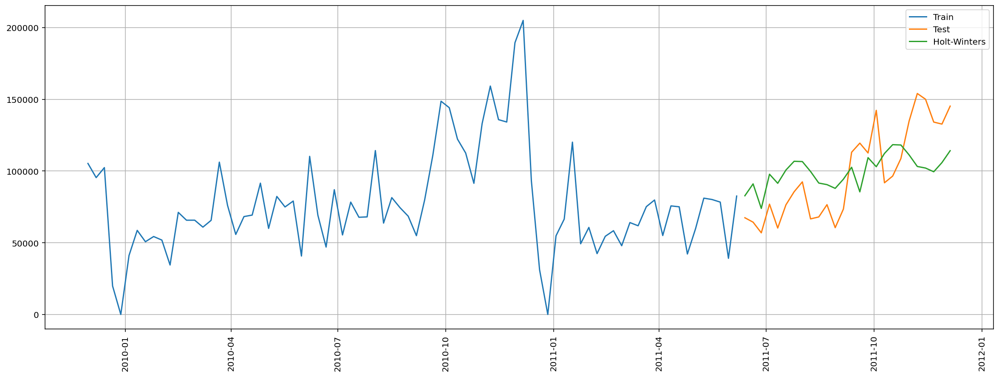

In [0]:
train, test = df_all_week1.iloc[:80, 0], df_all_week1.iloc[80:, 0]
model = ExponentialSmoothing(train, seasonal='add', trend = 'add', seasonal_periods=12).fit()
pred = model.predict(start=80, end=105)

print("WAPE error: {}".format(wape(pred, test)))
print("MAE error: {}".format( mean_absolute_error(test, pred)))

plt.plot(train.index, train, label='Train')
plt.plot(test.index, test, label='Test')
plt.plot(pred.index, pred, label='Holt-Winters')
plt.xticks(rotation = 90)
plt.legend(loc='best')
plt.grid()
plt.gcf().set_size_inches((20,7))

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning)


WAPE error: 29.699658333238048
MAE error: 29256.1510507587


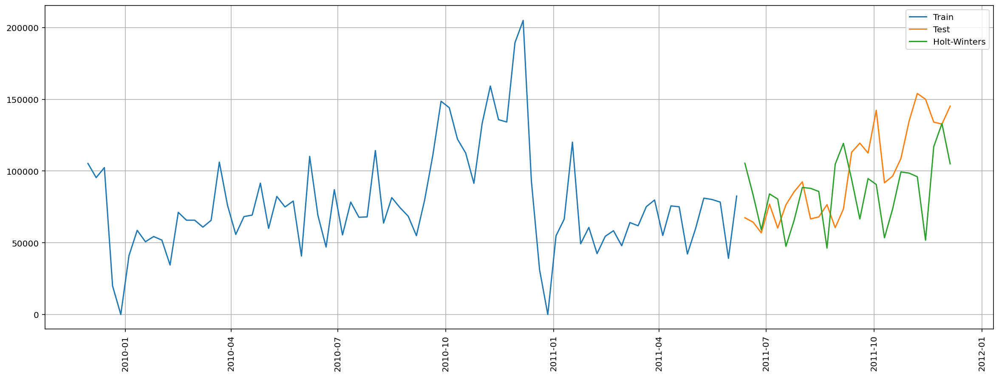

In [0]:
train, test = df_all_week1.iloc[:80, 0], df_all_week1.iloc[80:, 0]
model = ExponentialSmoothing(train, seasonal='mul', trend = 'add', seasonal_periods=12).fit()
pred = model.predict(start=80, end=105)

print("WAPE error: {}".format(wape(pred, test)))
print("MAE error: {}".format( mean_absolute_error(test, pred)))

plt.plot(train.index, train, label='Train')
plt.plot(test.index, test, label='Test')
plt.plot(pred.index, pred, label='Holt-Winters')
plt.xticks(rotation = 90)
plt.legend(loc='best')
plt.grid()
plt.gcf().set_size_inches((20,7))

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning)


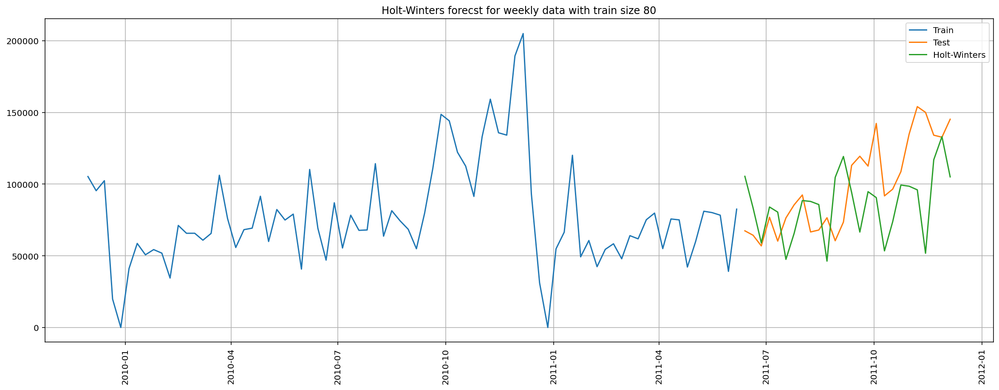

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning)


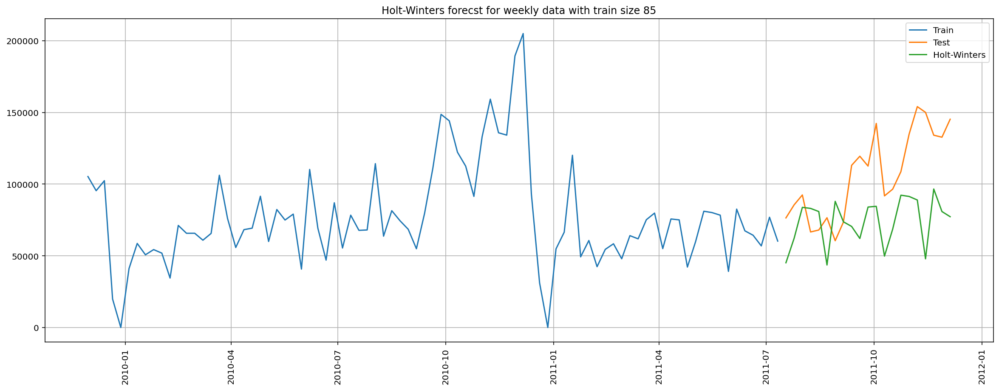

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning)


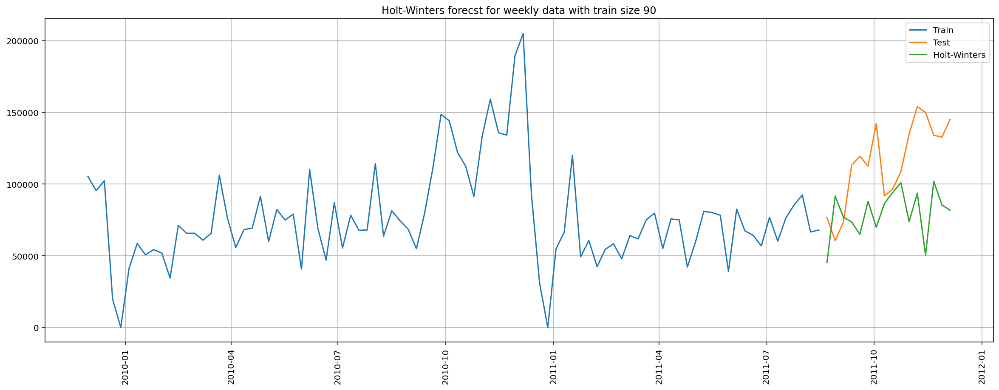

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning)


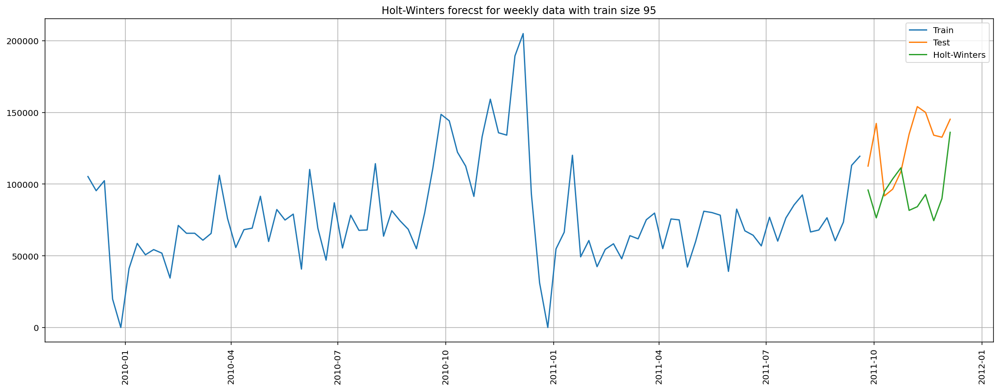

/usr/local/lib/python3.6/dist-packages/statsmodels/tsa/holtwinters.py:712: ConvergenceWarning: Optimization failed to converge. Check mle_retvals.
  ConvergenceWarning)


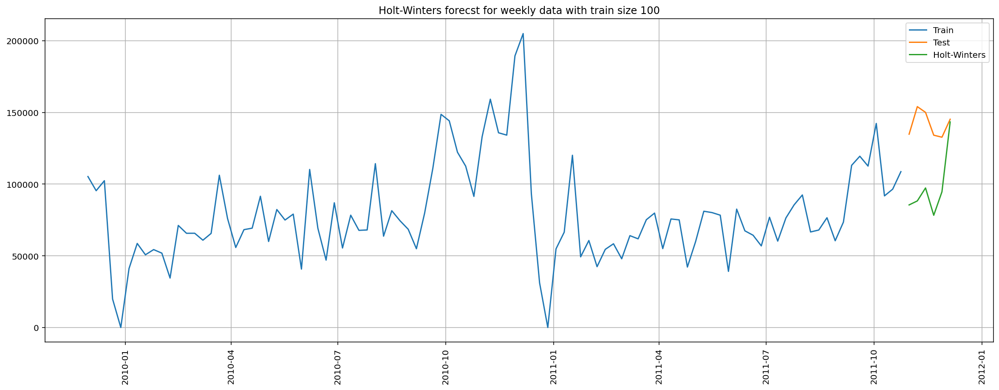

In [0]:
for start in range (80, 102, 5):
    train, test = df_all_week1.iloc[:start, 0], df_all_week1.iloc[start:, 0]
    model = ExponentialSmoothing(train, seasonal='mul', trend = 'add', seasonal_periods=12).fit()
    pred = model.predict(start=start, end=105)

    plt.plot(train.index, train, label='Train')
    plt.plot(test.index, test, label='Test')
    plt.plot(pred.index, pred, label='Holt-Winters')
    plt.xticks(rotation = 90)
    plt.legend(loc='best')
    plt.grid()
    plt.gcf().set_size_inches((20,7))
    plt.title('Holt-Winters forecst for weekly data with train size {}'.format(start))
    plt.show()

Результаты прогноза сильно зависят от разбиения на train и test, так как в зависимости от этого будут сильно отличаться коэффициенты сезонности и тренда

WAPE error: 24.782929274564847
MAE error: 24412.843885328595


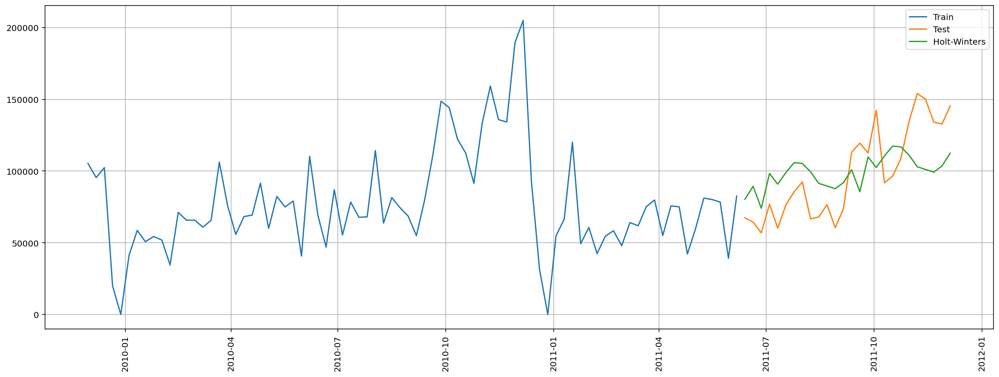

In [0]:
train, test = df_all_week0.iloc[:80, 0], df_all_week0.iloc[80:, 0]
model = ExponentialSmoothing(endog = train, seasonal='add', trend = 'add', seasonal_periods=12)
fit_model = model.fit()
params = fit_model.params
pred = fit_model.predict(start=80, end=105)

print("WAPE error: {}".format(wape(pred, test)))
print("MAE error: {}".format( mean_absolute_error(test, pred)))

plt.plot(train.index, train, label='Train')
plt.plot(test.index, test, label='Test')
plt.plot(pred.index, pred, label='Holt-Winters')
plt.xticks(rotation = 90)
plt.legend(loc='best')
plt.grid()
plt.gcf().set_size_inches((20,7))

**Экспоненциональное сглаживание Хольта**

In [0]:
from statsmodels.tsa.holtwinters import Holt

WAPE error: 18.613921393464498
MAE error: 18335.958273455784


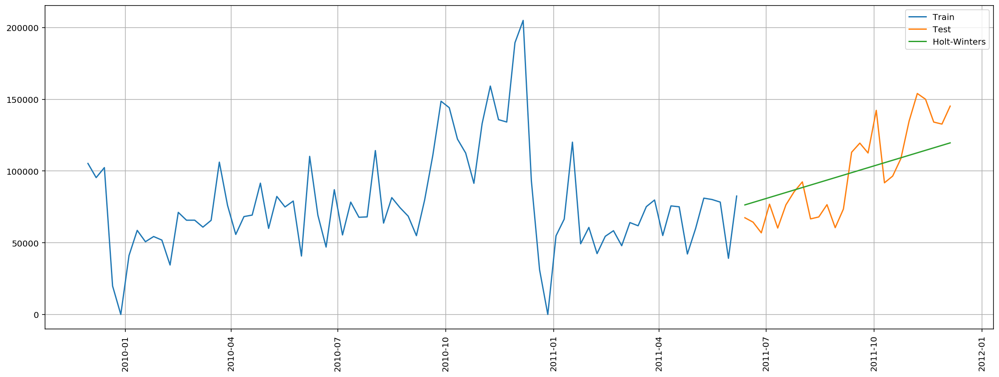

In [0]:
train, test = df_all_week1.iloc[:80, 0], df_all_week1.iloc[80:, 0]
model = Holt(train).fit(smoothing_level=0.8, smoothing_slope=0.2, optimized=False)
pred = model.predict(start=80, end=105)

print("WAPE error: {}".format(wape(pred, test)))
print("MAE error: {}".format( mean_absolute_error(test, pred)))

plt.plot(train.index, train, label='Train')
plt.plot(test.index, test, label='Test')
plt.plot(pred.index, pred, label='Holt-Winters')
plt.xticks(rotation = 90)
plt.legend(loc='best')
plt.grid()
plt.gcf().set_size_inches((20,7))

Как достать тренд и сезонность? Достала



Long Short Term Memory Neural Network

**LSTM для данных на ежедневной основе + ln + десезонализация**

In [0]:
import pandas as pd

In [0]:
from google.colab import drive
drive.mount('/content/gdrive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive


In [0]:
df_all_days0_ln = pd.read_csv('gdrive/My Drive/final_timeseries.csv')
result_daysln = pd.read_csv('gdrive/My Drive/seasonal_coeff.csv')
df_all_days0 = pd.read_csv('gdrive/My Drive/original_timeseries.csv')

seas_holt = pd.read_csv('gdrive/My Drive/HoltWinters_seas.csv')
level_holt = pd.read_csv('gdrive/My Drive/HoltWinters_trend.csv')

In [0]:
seas_holt = seas_holt['seasonal'].to_list()[-739:]
trend_holt = level_holt['trend'].to_list()[-739:]

In [0]:
df_all_days0_ln.index = df_all_days0_ln['year-month-day']
df_all_days0.index =  df_all_days0['year-month-day']
result_daysln.index = result_daysln['year-month-day']

In [0]:
df_all_days0_ln = df_all_days0_ln.drop(['year-month-day'], axis = 1)
df_all_days0 = df_all_days0.drop(['year-month-day'], axis = 1)
result_daysln = result_daysln.drop(['year-month-day'], axis = 1)

In [0]:
df_all_days0.head()

,Quantity
year-month-day,
2009-12-01,18719.0
2009-12-02,22892.0
2009-12-03,43590.0
2009-12-04,16330.0
2009-12-05,3764.0


In [0]:
df_all_days0_ln['Quantity'] = df_all_days0_ln['Quantity'] - result_daysln['Quantity']

In [0]:
df_all_days0_ln.index.freq = 'D'

In [0]:
import tensorflow as tf
import keras
from keras import backend as K

Using TensorFlow backend.


In [0]:
dataset = df_all_days0_ln.values
dataset = np.reshape(dataset, (-1, 1))

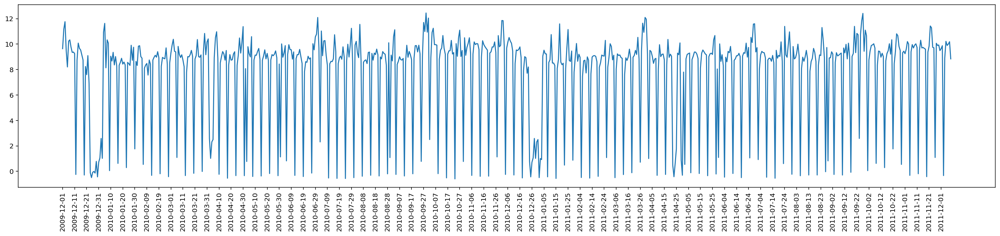

In [0]:
plt.plot(df_all_days0_ln.index, df_all_days0_ln['Quantity'])
plt.gcf().set_size_inches((26,5))
plt.xticks(df_all_days0_ln.index[::10],rotation =90)
plt.show()

In [0]:
import keras
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM
from keras.layers import Dropout
from keras.layers import *
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.preprocessing import StandardScaler

In [0]:
def create_dataset(dataset, look_back=1):
	dataX, dataY = [], []
	for i in range(len(dataset)-look_back):
		a = dataset[i:(i+look_back), 0]
		dataX.append(a)
		dataY.append(dataset[i + look_back, 0])
	return np.array(dataX), np.array(dataY)


# split into train and test sets
train_size = int(len(dataset) * 0.8)
test_size = len(dataset) - train_size
train, test = dataset[0:train_size,:], dataset[train_size:len(dataset),:]

scaler = StandardScaler()
train_scl = scaler.fit_transform(train)
test_scl = scaler.transform(test)

# reshape into X=t:t+16 and Y=t+17
look_back = 16
trainX, trainY = create_dataset(train_scl, look_back)
testX, testY = create_dataset(test_scl, look_back)
seasonal_coeff_test = result_daysln['Quantity'].to_list()[train_size+look_back:len(dataset)]
# reshape input to be [samples, time steps, features]
trainX = np.reshape(trainX, (trainX.shape[0], 1, trainX.shape[1]))
testX = np.reshape(testX, (testX.shape[0], 1, testX.shape[1]))

In [0]:
model = Sequential()
model.add(LSTM(200, input_shape=(1, look_back)))
model.add(Dense(500, activation='tanh'))
model.add(Dropout(0.2))
model.add(Dense(1))
model.compile(loss='mean_squared_error', optimizer='adam')
model.fit(trainX, trainY, epochs=5000, batch_size=len(trainX), validation_data=(testX, testY), verbose=0)
# make predictions
trainPredict = model.predict(trainX)
testPredict = model.predict(testX)

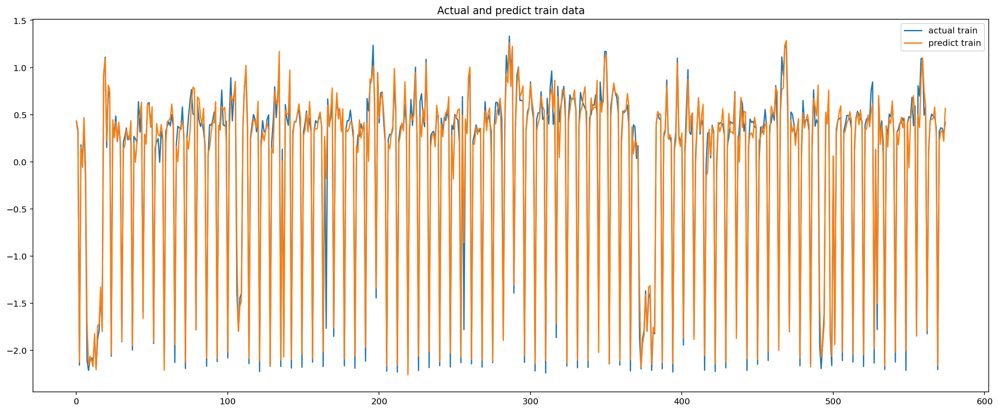

In [0]:
idx = np.arange(trainY.shape[0])
plt.figure(figsize=(20, 8))
plt.plot(idx, trainY, label = 'actual train')
plt.plot(idx, trainPredict, label = 'predict train')
plt.legend()
plt.title("Actual and predict train data")
plt.show()

In [0]:
import numpy as np
def wape(y_true, y_pred):
    res = np.sum(np.abs(y_true - y_pred)) / np.sum(y_true) * 100
    return res


def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true)+1, np.array(y_pred)+1
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [0]:
print("Mean squared error", mean_squared_error(trainY, trainPredict))
print("Mean absolute error", mean_absolute_error(trainY, trainPredict))

Mean squared error 0.023410420688839133
Mean absolute error 0.09897918817414565


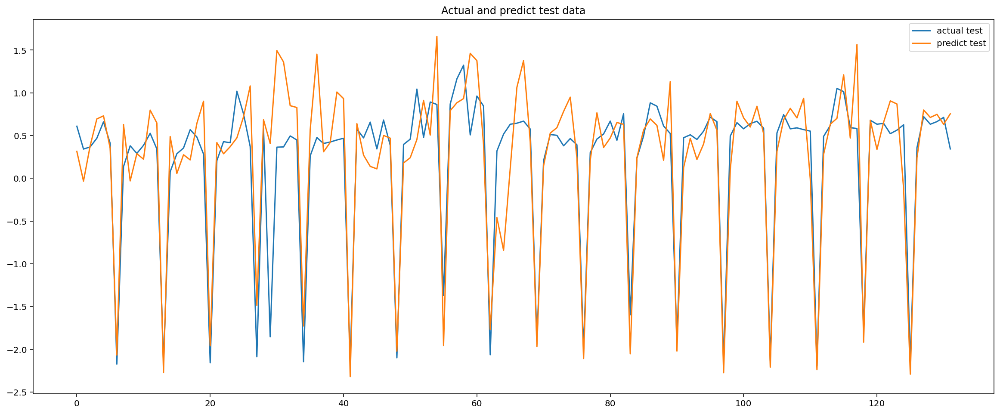

In [0]:
idx = np.arange(testY.shape[0])
plt.figure(figsize=(20, 8))
plt.plot(idx, testY, label = "actual test")
plt.plot(idx, testPredict, label = "predict test")
plt.legend()
plt.title("Actual and predict test data")
plt.show()

In [0]:
print("Mean squared error", mean_squared_error(testY, testPredict))
print("Mean absolute error", mean_absolute_error(testY, testPredict))

Mean squared error 0.18564130977492313
Mean absolute error 0.3017738469710388


In [0]:
testPredict_final = scaler.inverse_transform(testPredict)
testPredict_final = testPredict_final + np.array(seasonal_coeff_test).reshape(len(seasonal_coeff_test), 1)
testPredict_final = np.expm1(testPredict_final)

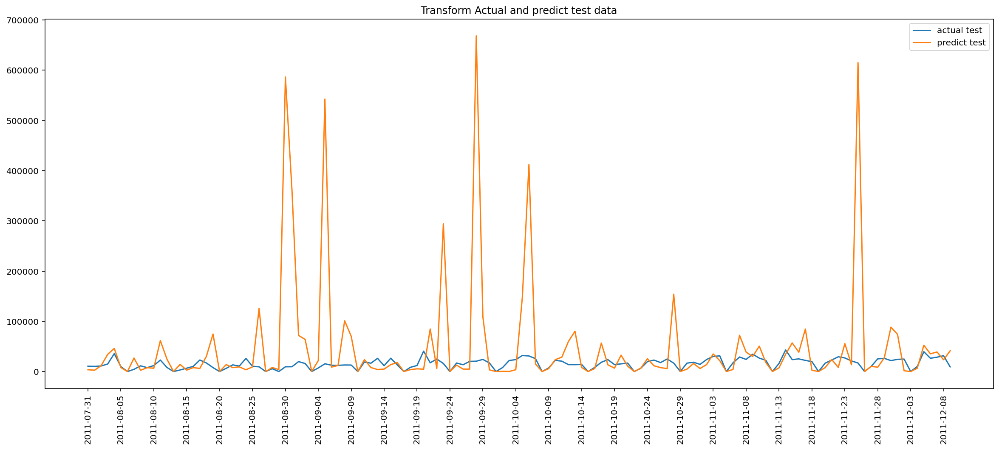

In [0]:
idx = df_all_days0[train_size+look_back:].index.to_list()
plt.figure(figsize=(20, 8))
plt.plot(idx, df_all_days0[train_size+look_back:], label = "actual test")
plt.plot(idx, testPredict_final, label = "predict test")
plt.legend()
plt.xticks(idx[::5], rotation = 90)
plt.title("Transform Actual and predict test data")
plt.show()

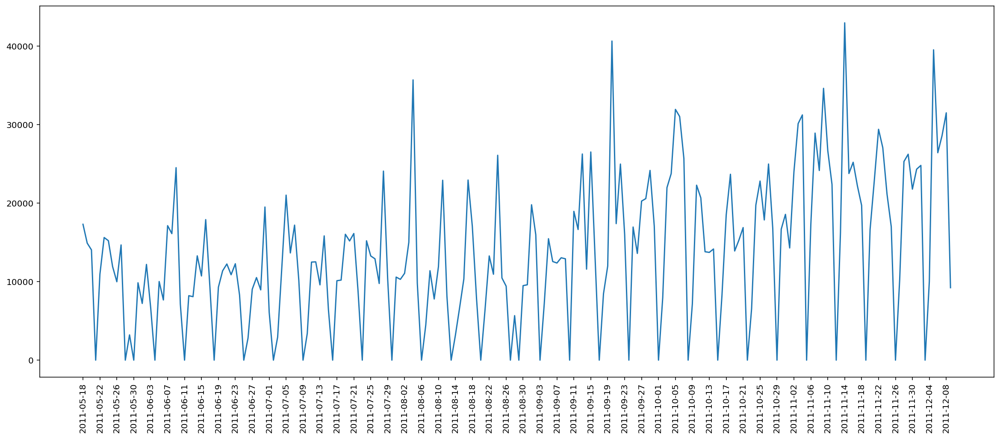

In [0]:
plt.figure(figsize=(20, 8))
plt.plot(idx, df_all_days0[train_size+look_back:])
plt.xticks(idx[::4], rotation = 90)
plt.show()

  **Другая модель**

In [0]:
def create_dataset(dataset, look_back=1):
	dataX, dataY = [], []
	for i in range(len(dataset)-look_back):
		a = dataset[i:(i+look_back), 0]
		dataX.append(a)
		dataY.append(dataset[i + look_back, 0])
	return np.array(dataX), np.array(dataY)


In [0]:
# split into train and test sets
train_size = int(len(dataset) * 0.8)
test_size = len(dataset) - train_size
train, test = dataset[0:train_size,:], dataset[train_size:len(dataset),:]

scaler = StandardScaler()
train_scl = scaler.fit_transform(train)
test_scl = scaler.transform(test)

# reshape into X=t:t+16 and Y=t+17
look_back = 14
trainX, trainY = create_dataset(train_scl, look_back)
testX, testY = create_dataset(test_scl, look_back)
seasonal_coeff_test = result_daysln['Quantity'].to_list()[train_size+look_back:len(dataset)]
# reshape input to be [samples, time steps, features]
trainX = np.reshape(trainX, (trainX.shape[0], 1, trainX.shape[1]))
testX = np.reshape(testX, (testX.shape[0], 1, testX.shape[1]))

In [0]:
model = Sequential()
model.add(LSTM(150, input_shape=(1, look_back)))
model.add(Dense(300, activation='relu'))
model.add(Dropout(0.4))
model.add(Dense(1))
model.compile(loss='mean_squared_error', optimizer='adam')
model.fit(trainX, trainY, epochs=5000, batch_size=len(trainX), validation_data=(testX, testY), verbose=0)
# make predictions
trainPredict = model.predict(trainX)
testPredict = model.predict(testX)

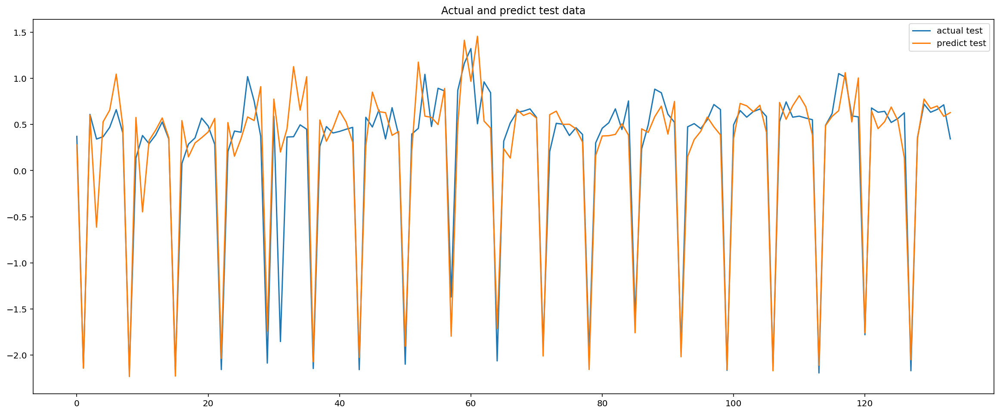

In [0]:
idx = np.arange(testY.shape[0])
plt.figure(figsize=(20, 8))
plt.plot(idx, testY, label = "actual test")
plt.plot(idx, testPredict, label = "predict test")
plt.legend()
plt.title("Actual and predict test data")
plt.show()

In [0]:
print("Mean squared error", mean_squared_error(testY, testPredict))
print("Mean absolute error", mean_absolute_error(testY, testPredict))

Mean squared error 0.10558912007038566
Mean absolute error 0.2119862129322507


In [0]:
testPredict_final = scaler.inverse_transform(testPredict)
testPredict_final = testPredict_final + np.array(seasonal_coeff_test).reshape(len(seasonal_coeff_test), 1)
testPredict_final = np.expm1(testPredict_final)

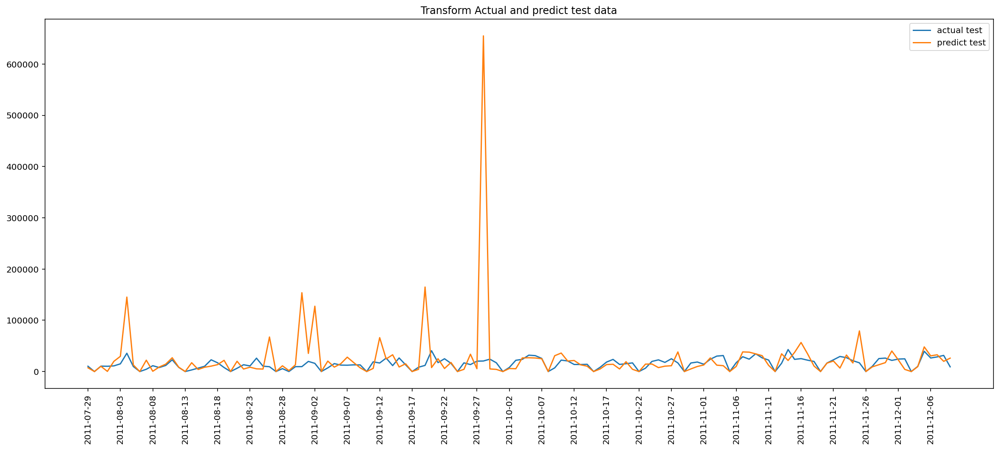

In [0]:
idx = df_all_days0[train_size+look_back:].index.to_list()
plt.figure(figsize=(20, 8))
plt.plot(idx, df_all_days0[train_size+look_back:], label = "actual test")
plt.plot(idx, testPredict_final, label = "predict test")
plt.legend()

plt.grid()
plt.xlabel('Date')
plt.ylabel('Quantity')

plt.xticks(idx[::5], rotation = 90)
plt.title("Transform Actual and predict test data")
plt.show()

**LSTM + десезонализация + нормализация**


In [0]:
from statsmodels.tsa.seasonal import seasonal_decompose

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [0]:
result_day_alldays = seasonal_decompose(df_all_days0['Quantity'], model='additive', freq = 90)

In [0]:
%config InlineBackend.figure_format = 'retina'
import matplotlib.pyplot as plt

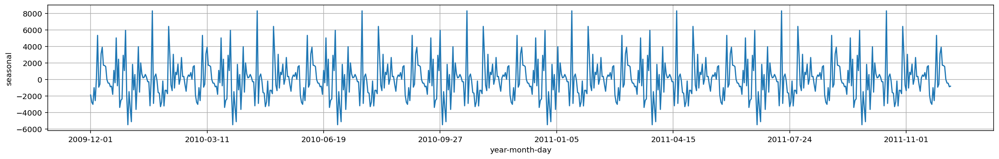

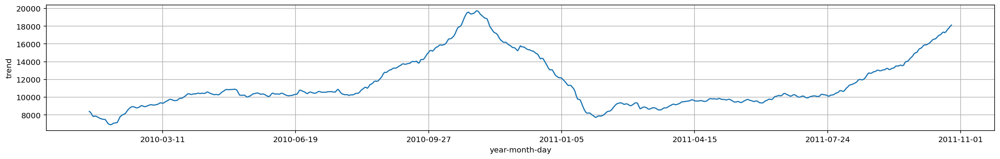

In [0]:
#result_day_alldays.plot()
result_day_alldays.seasonal.plot()
plt.gcf().set_size_inches((22,3))
plt.ylabel('seasonal')
plt.grid()
plt.show()
result_day_alldays.trend.plot()
plt.gcf().set_size_inches((22,3))
plt.ylabel('trend')
plt.grid()
plt.show()

In [0]:
df_all_days0_deseas = df_all_days0.copy()
df_all_days0_deseas['Quantity'] = df_all_days0_deseas['Quantity'] - result_day_alldays.seasonal

In [0]:
dataset = df_all_days0_deseas.values
dataset = np.reshape(dataset, (-1, 1))

In [0]:
# split into train and test sets
train_size = int(len(dataset) * 0.85)
test_size = len(dataset) - train_size
train, test = dataset[0:train_size,:], dataset[train_size:len(dataset),:]

scaler = StandardScaler()
train_scl = scaler.fit_transform(train)
test_scl = scaler.transform(test)

# reshape into X=t:t+14 and Y=t+15
look_back = 14
trainX, trainY = create_dataset(train_scl, look_back)
testX, testY = create_dataset(test_scl, look_back)
seasonal_coeff_test = result_day_alldays.seasonal.to_list()[train_size+look_back:len(dataset)]
# reshape input to be [samples, time steps, features]
trainX = np.reshape(trainX, (trainX.shape[0], 1, trainX.shape[1]))
testX = np.reshape(testX, (testX.shape[0], 1, testX.shape[1]))

In [0]:
model = Sequential()
model.add(LSTM(200, input_shape=(1, look_back)))
model.add(Dense(400, activation='relu'))
model.add(Dropout(0.4))
model.add(Dense(1))
model.compile(loss='mean_squared_error', optimizer='adam')
model.fit(trainX, trainY, epochs=5000, batch_size=len(trainX), validation_data=(testX, testY), verbose=0)
# make predictions
trainPredict = model.predict(trainX)
testPredict = model.predict(testX)

In [0]:
testPredict_final = scaler.inverse_transform(testPredict)
testPredict_final = testPredict_final + np.array(seasonal_coeff_test).reshape(len(seasonal_coeff_test), 1)
testPredict_final[testPredict_final < 0] = 0

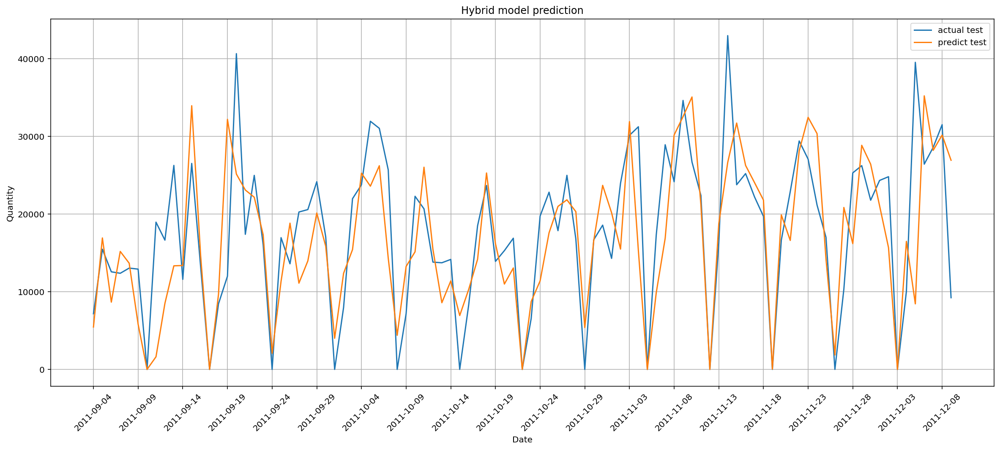

In [0]:
idx = df_all_days0[train_size+look_back:].index.to_list()
plt.figure(figsize=(20, 8))
plt.plot(idx, df_all_days0[train_size+look_back:], label = "actual test")
plt.plot(idx, testPredict_final, label = "predict test")
plt.legend()
plt.grid()
plt.xlabel('Date')
plt.ylabel('Quantity')
plt.xticks(idx[::5], rotation = 45)
plt.title("Hybrid model prediction")
plt.show()

In [0]:
print("Mean squared error", mean_squared_error(df_all_days0[train_size+look_back:], testPredict_final))
print("Mean absolute error", mean_absolute_error(df_all_days0[train_size+look_back:], testPredict_final))
print("WAPE", wape(df_all_days0[train_size+look_back:], testPredict_final))

Mean squared error 53537063.81804199
Mean absolute error 5422.0668143411385
WAPE Quantity    30.772589
dtype: float64


In [0]:
%config InlineBackend.figure_format = 'retina'
import matplotlib.pyplot as plt

**ПОДБОР РАЗМЕРА ВХОДНОГО ОКНА**

Mean absolute error 8175.291920971374
WAPE Quantity    48.710046
dtype: float64


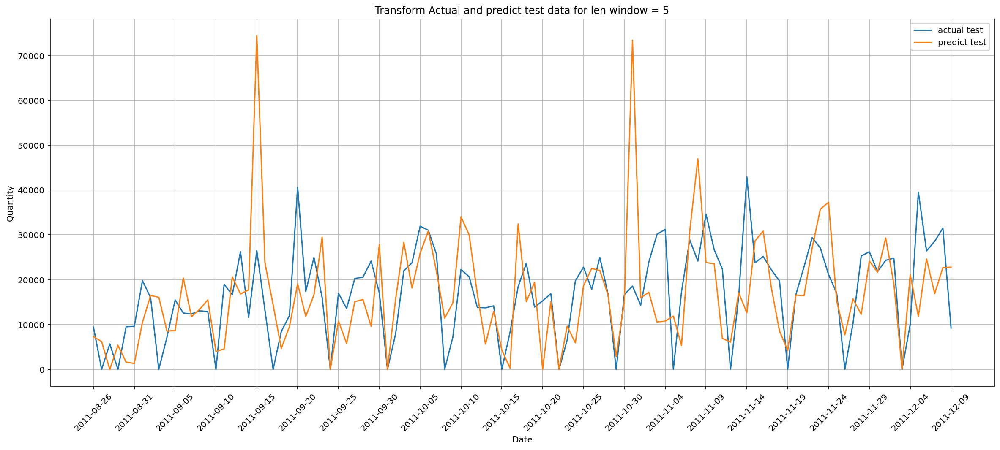

Mean absolute error 7649.194523716108
WAPE Quantity    45.385809
dtype: float64


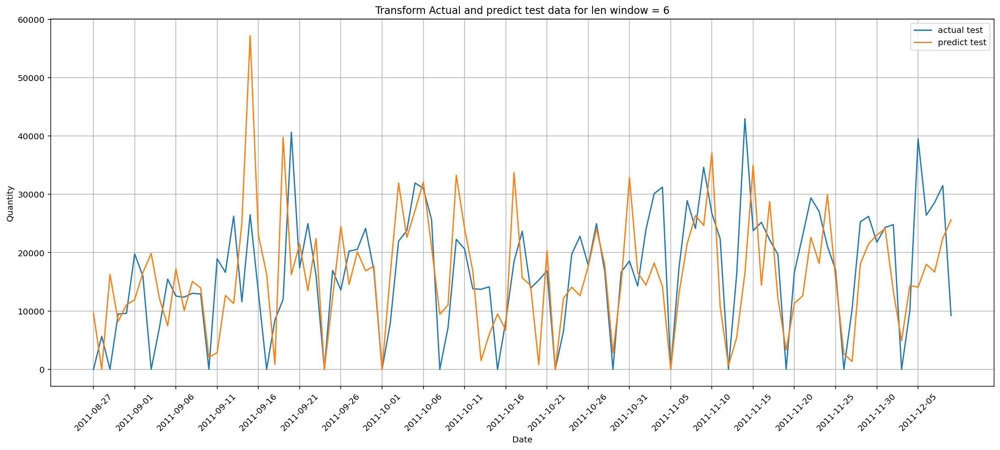

Mean absolute error 6432.820343469856
WAPE Quantity    37.805052
dtype: float64


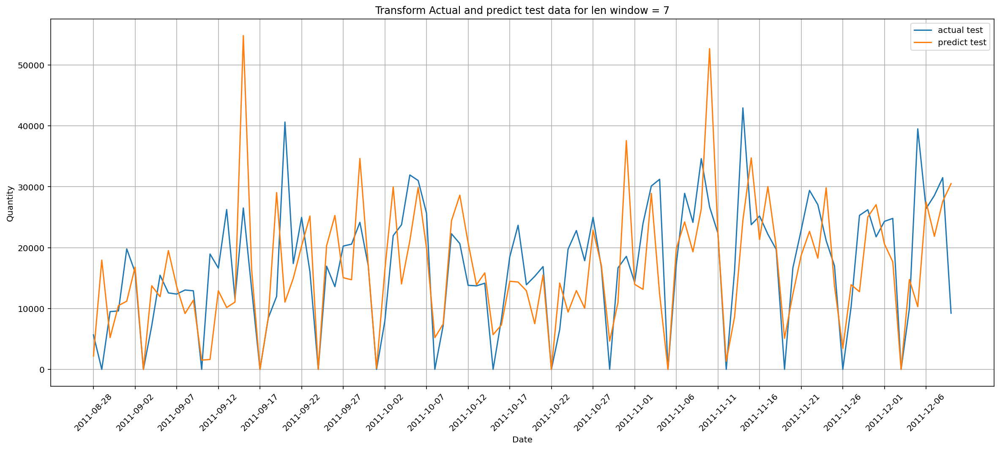

Mean absolute error 6650.172787170593
WAPE Quantity    38.831056
dtype: float64


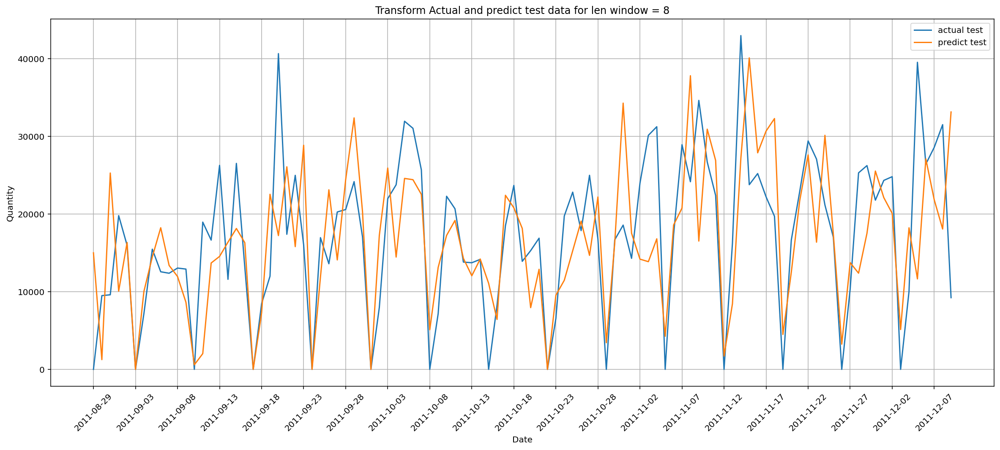

Mean absolute error 6252.61443018092
WAPE Quantity    36.155209
dtype: float64


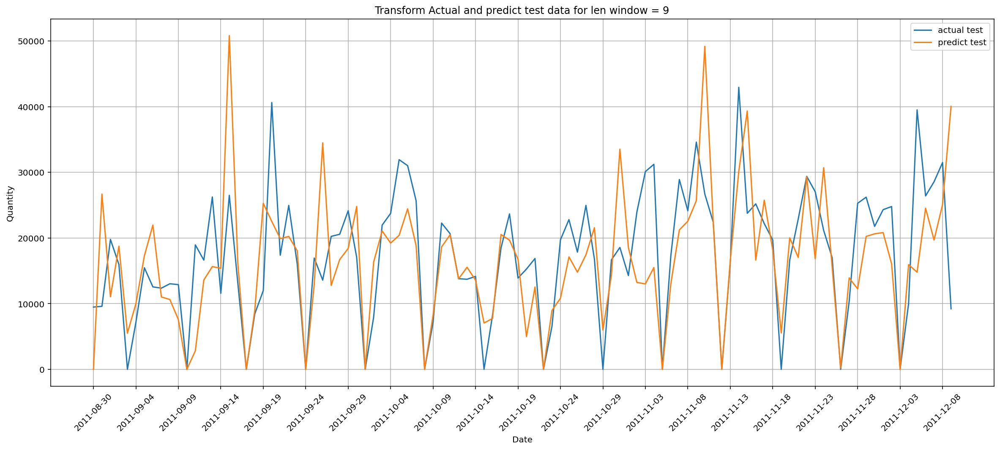

Mean absolute error 6262.158983048463
WAPE Quantity    36.049338
dtype: float64


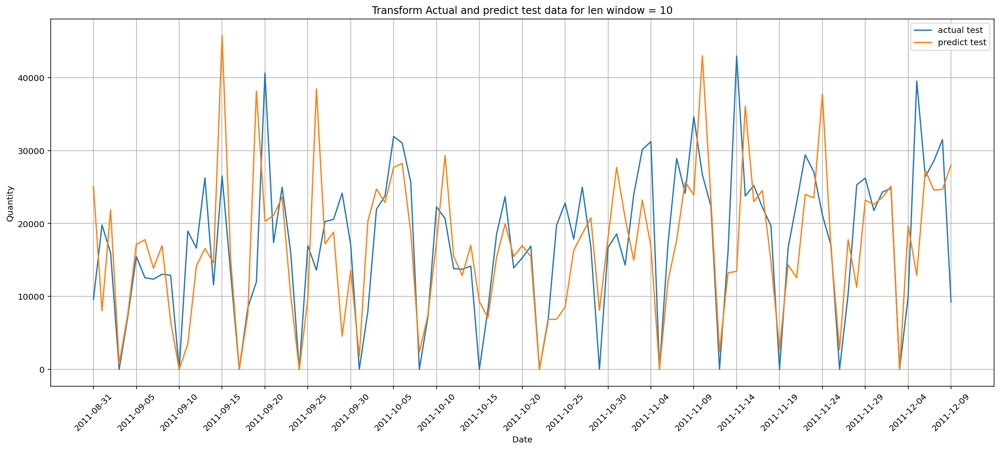

Mean absolute error 6306.0837831977915
WAPE Quantity    36.140501
dtype: float64


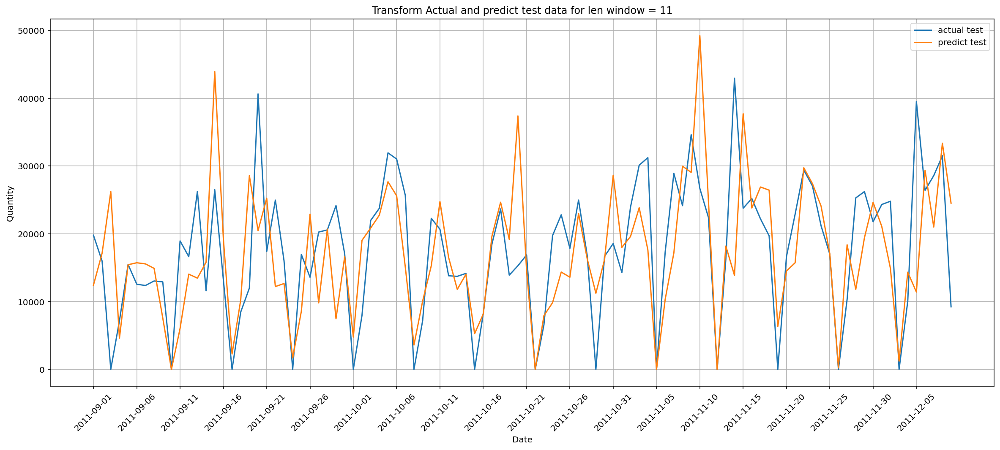

Mean absolute error 7130.429671249272
WAPE Quantity    40.920331
dtype: float64


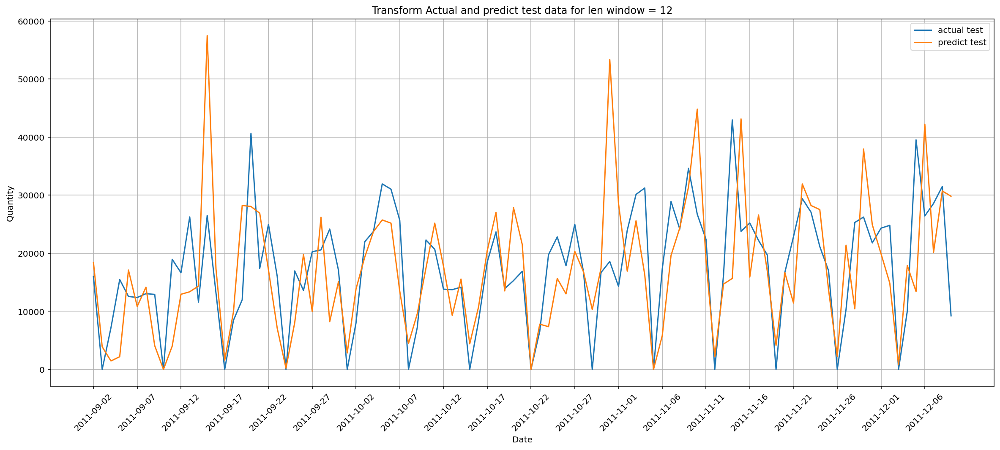

Mean absolute error 6821.530102272191
WAPE Quantity    39.114278
dtype: float64


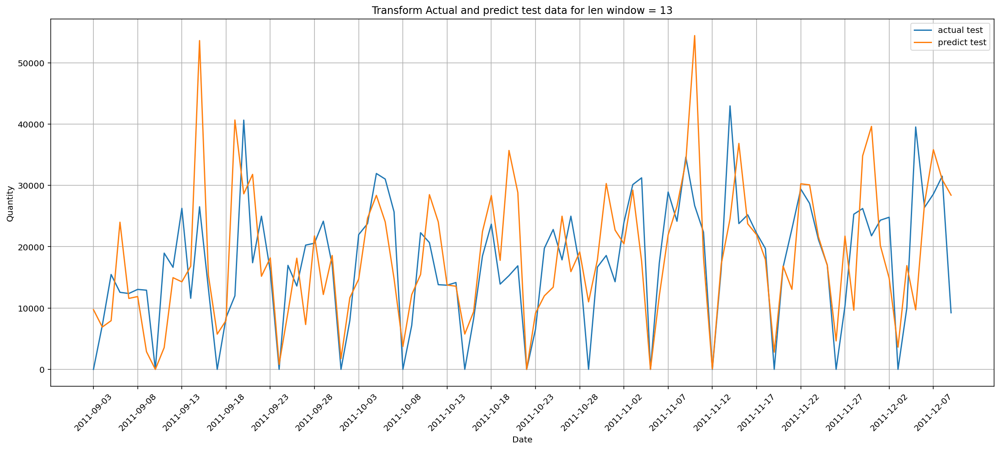

Mean absolute error 5535.841165109873
WAPE Quantity    31.418308
dtype: float64


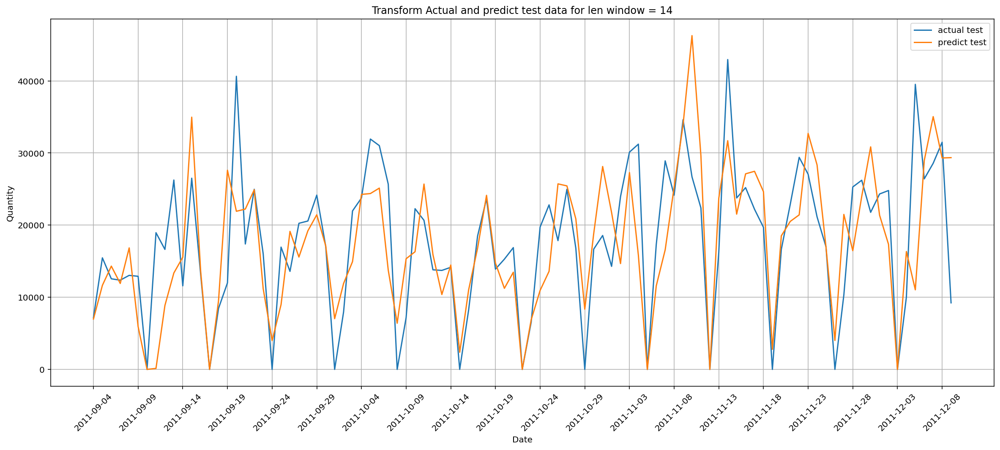

Mean absolute error 6037.906906277019
WAPE Quantity    34.05729
dtype: float64


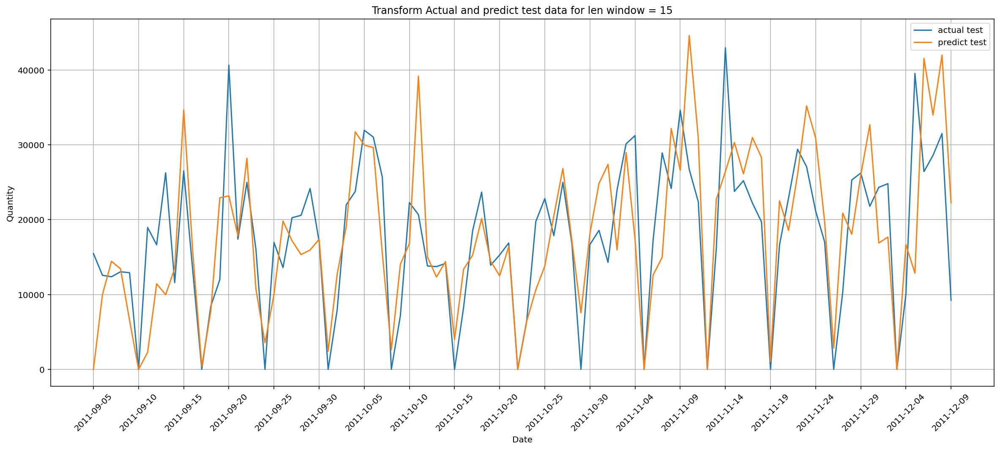

Mean absolute error 6298.479953941211
WAPE Quantity    35.47945
dtype: float64


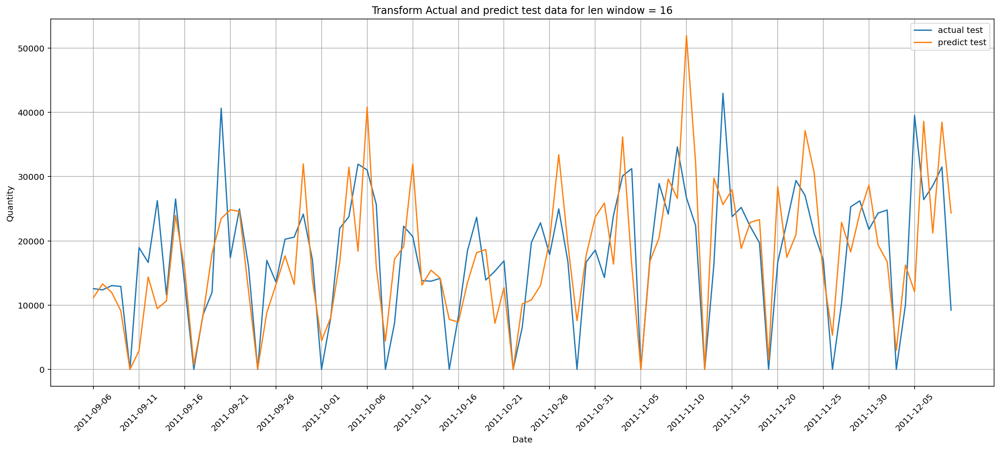

Mean absolute error 6681.377123896278
WAPE Quantity    37.519592
dtype: float64


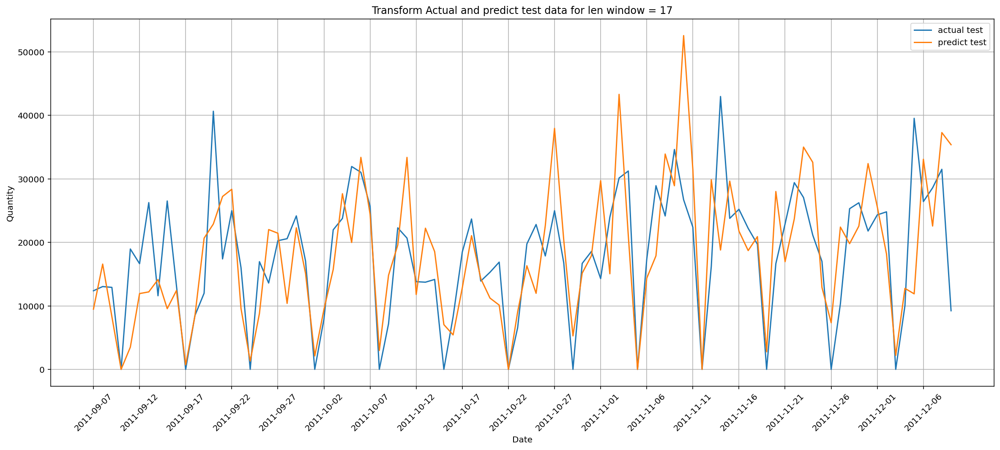

Mean absolute error 6926.132571734128
WAPE Quantity    38.766741
dtype: float64


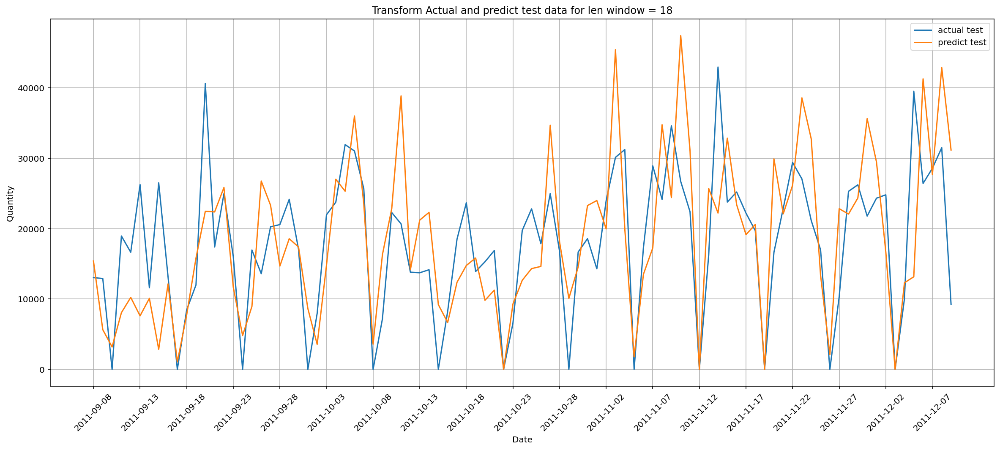

Mean absolute error 6384.138730489629
WAPE Quantity    35.628454
dtype: float64


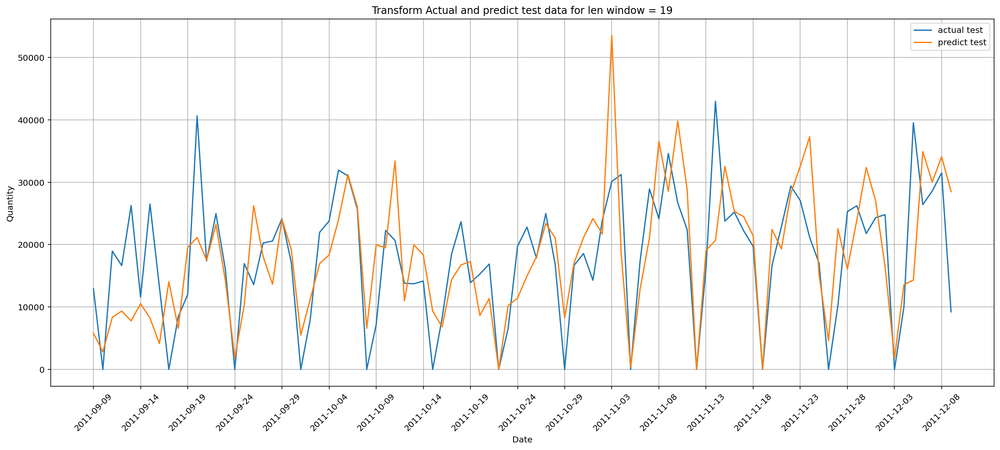

Mean absolute error 6433.4687518726105
WAPE Quantity    35.793741
dtype: float64


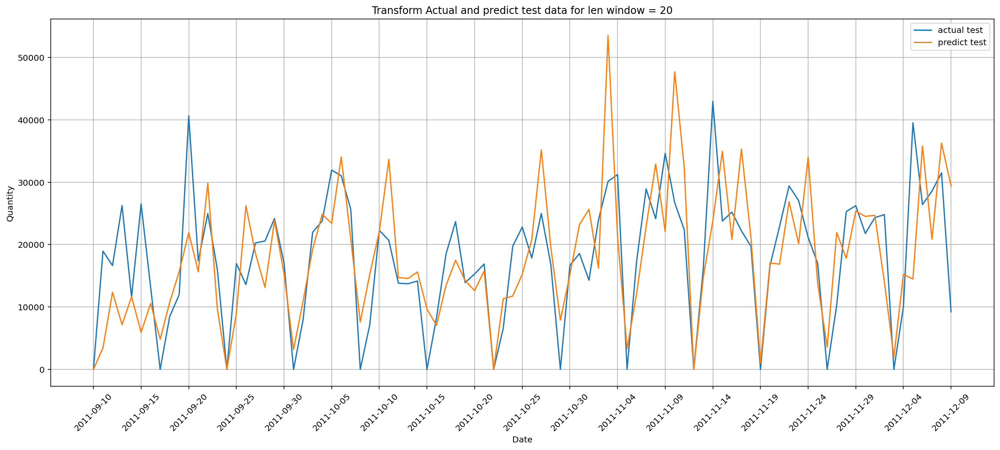

Mean absolute error 7551.393521546187
WAPE Quantity    41.551827
dtype: float64


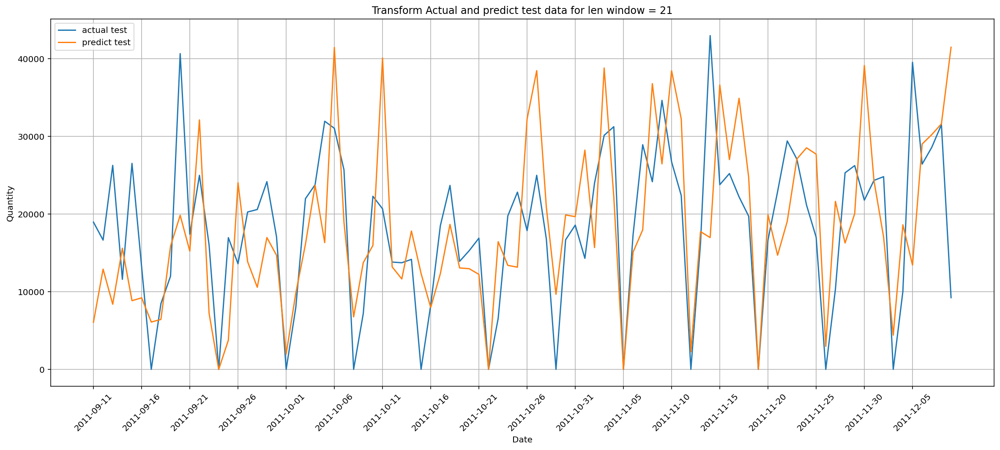

Mean absolute error 6558.060753726696
WAPE Quantity    36.10331
dtype: float64


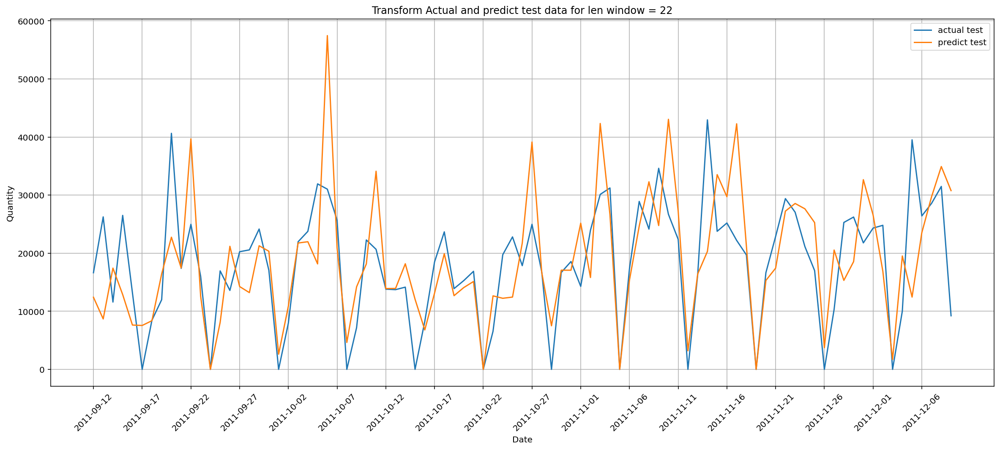

Mean absolute error 7168.643744016069
WAPE Quantity    39.426974
dtype: float64


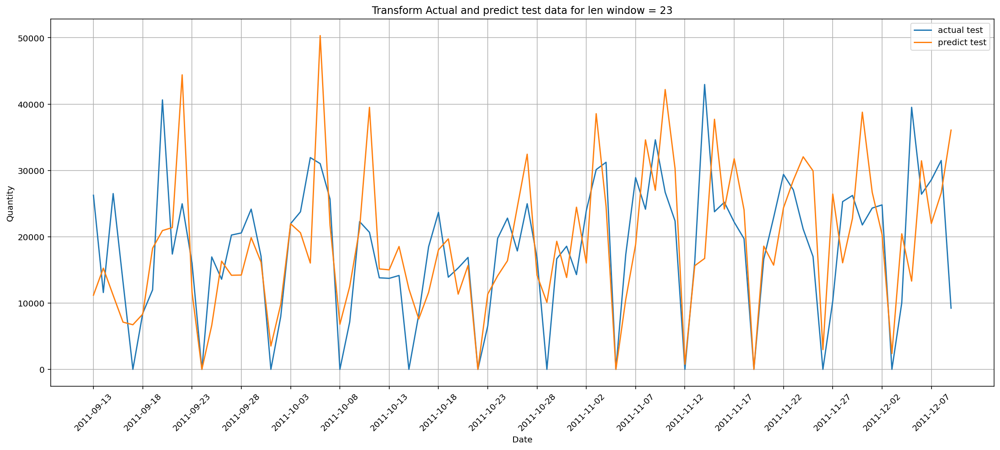

Mean absolute error 6894.364105473482
WAPE Quantity    38.112918
dtype: float64


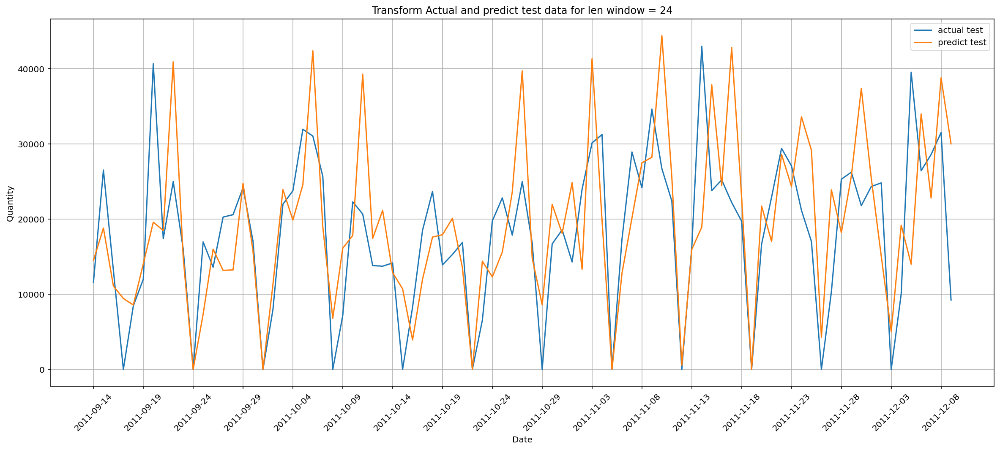

Mean absolute error 6706.809974113052
WAPE Quantity    36.921773
dtype: float64


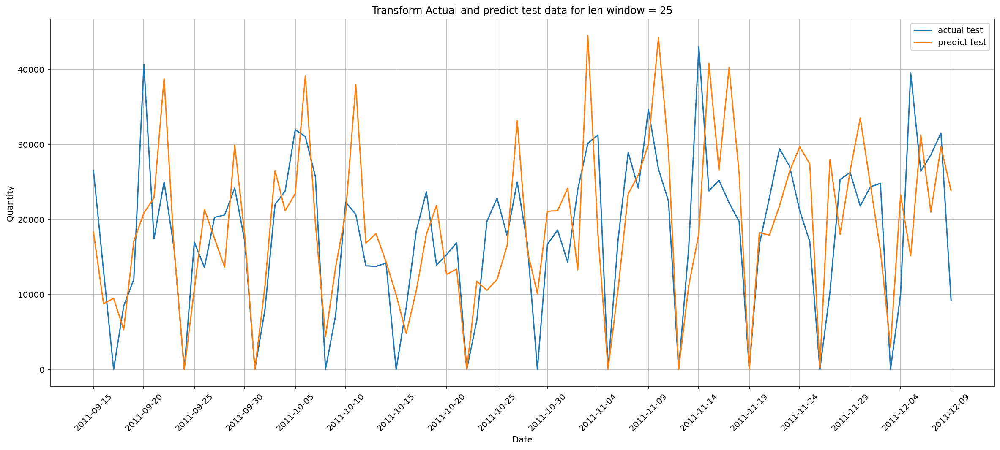

Mean absolute error 7275.347005252404
WAPE Quantity    40.269256
dtype: float64


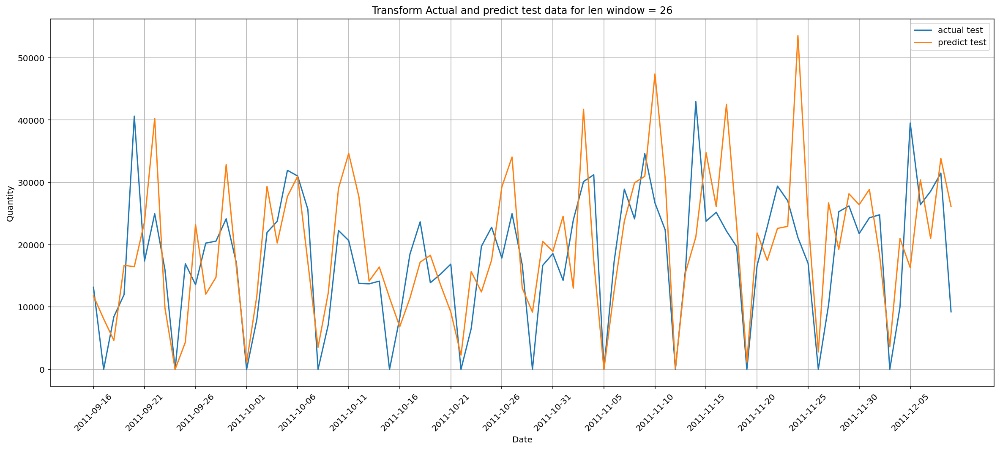

Mean absolute error 6994.336774816226
WAPE Quantity    38.589596
dtype: float64


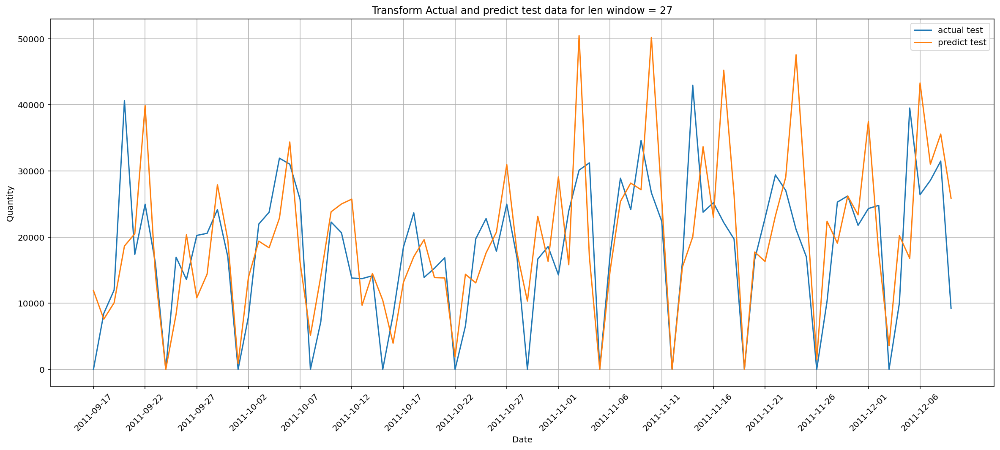

Mean absolute error 6543.656086465261
WAPE Quantity    35.673274
dtype: float64


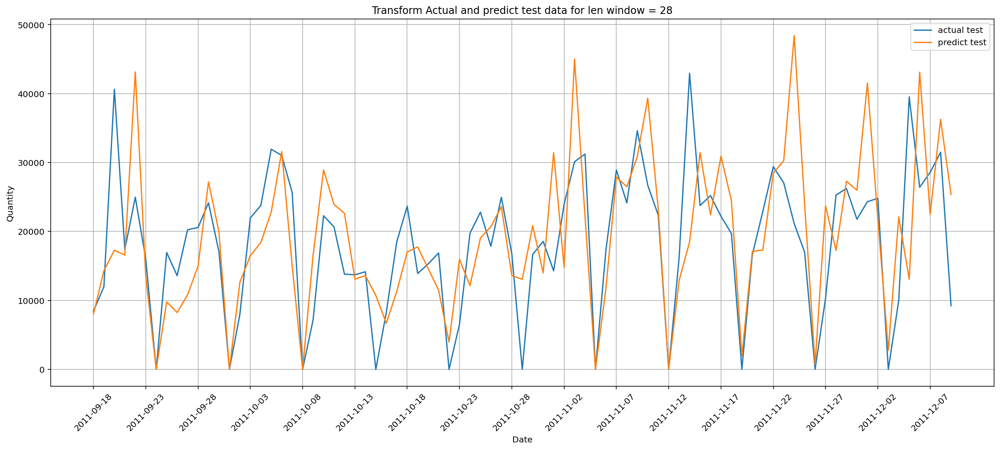

Mean absolute error 6302.0864233590655
WAPE Quantity    34.131931
dtype: float64


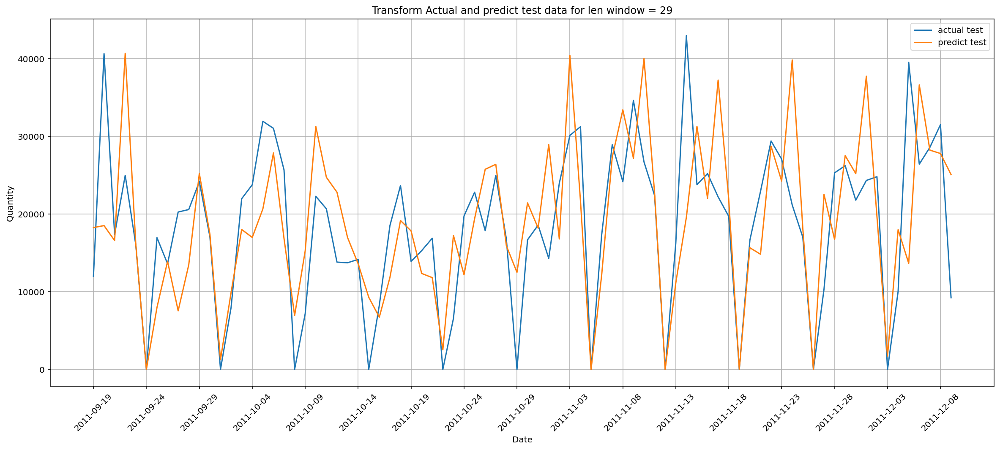

In [0]:
# split into train and test sets
train_size = int(len(dataset) * 0.85)
test_size = len(dataset) - train_size
train, test = dataset[0:train_size,:], dataset[train_size:len(dataset),:]

scaler = StandardScaler()
train_scl = scaler.fit_transform(train)
test_scl = scaler.transform(test)

# reshape into X=t:t+16 and Y=t+17
for i in range(5, 30):
  look_back = i
  trainX, trainY = create_dataset(train_scl, look_back)
  testX, testY = create_dataset(test_scl, look_back)
  seasonal_coeff_test = result_day_alldays.seasonal.to_list()[train_size+look_back:len(dataset)]
  # reshape input to be [samples, time steps, features]
  trainX = np.reshape(trainX, (trainX.shape[0], 1, trainX.shape[1]))
  testX = np.reshape(testX, (testX.shape[0], 1, testX.shape[1]))

  model = Sequential()
  model.add(LSTM(200, input_shape=(1, look_back)))
  model.add(Dense(400, activation='relu'))
  model.add(Dropout(0.4))
  model.add(Dense(1))
  model.compile(loss='mean_squared_error', optimizer='adam')
  model.fit(trainX, trainY, epochs=5000, batch_size=len(trainX), validation_data=(testX, testY), verbose=0)
  # make predictions
  trainPredict = model.predict(trainX)
  testPredict = model.predict(testX)

  testPredict_final = scaler.inverse_transform(testPredict)
  testPredict_final = testPredict_final + np.array(seasonal_coeff_test).reshape(len(seasonal_coeff_test), 1)
  testPredict_final[testPredict_final < 0] = 0

  print("Mean absolute error", mean_absolute_error(df_all_days0[train_size+look_back:], testPredict_final))
  print("WAPE", wape(df_all_days0[train_size+look_back:], testPredict_final))

  idx = df_all_days0[train_size+look_back:].index.to_list()
  plt.figure(figsize=(20, 8))
  plt.plot(idx, df_all_days0[train_size+look_back:], label = "actual test")
  plt.plot(idx, testPredict_final, label = "predict test")
  plt.legend()
  plt.xticks(idx[::5], rotation = 45)
  plt.grid()
  plt.xlabel('Date')
  plt.ylabel('Quantity')
  plt.title("Transform Actual and predict test data for len window = {}".format(look_back))
  plt.show()


**LSTM для обычных рядов + нормализация**

In [0]:
import matplotlib.pyplot as plt

In [0]:
dataset = df_all_days0.values
dataset = np.reshape(dataset, (-1, 1))

In [0]:
# split into train and test sets
train_size = int(len(dataset) * 0.85)
test_size = len(dataset) - train_size
train, test = dataset[0:train_size,:], dataset[train_size:len(dataset),:]

scaler = StandardScaler()
train_scl = scaler.fit_transform(train)
test_scl = scaler.transform(test)

# reshape into X=t:t+14 and Y=t+15
look_back = 14
trainX, trainY = create_dataset(train_scl, look_back)
testX, testY = create_dataset(test_scl, look_back)
# reshape input to be [samples, time steps, features]
trainX = np.reshape(trainX, (trainX.shape[0], 1, trainX.shape[1]))
testX = np.reshape(testX, (testX.shape[0], 1, testX.shape[1]))

In [0]:
model = Sequential()
model.add(LSTM(200, input_shape=(1, look_back)))
model.add(Dense(400, activation='relu'))
model.add(Dropout(0.4))
model.add(Dense(1))
model.compile(loss='mean_squared_error', optimizer='adam')
model.fit(trainX, trainY, epochs=5000, batch_size=len(trainX), validation_data=(testX, testY), verbose=0)
# make predictions
trainPredict = model.predict(trainX)
testPredict = model.predict(testX)


In [0]:
testPredict_final = scaler.inverse_transform(testPredict)
testPredict_final[testPredict_final < 0] = 0

In [0]:
print("Mean squared error", mean_squared_error(df_all_days0[train_size+look_back:], testPredict_final))
print("Mean absolute error", mean_absolute_error(df_all_days0[train_size+look_back:], testPredict_final))
print("WAPE", wape(df_all_days0[train_size+look_back:], testPredict_final))

Mean squared error 84607427.1798818
Mean absolute error 7110.719766675811
WAPE Quantity    40.35643
dtype: float64


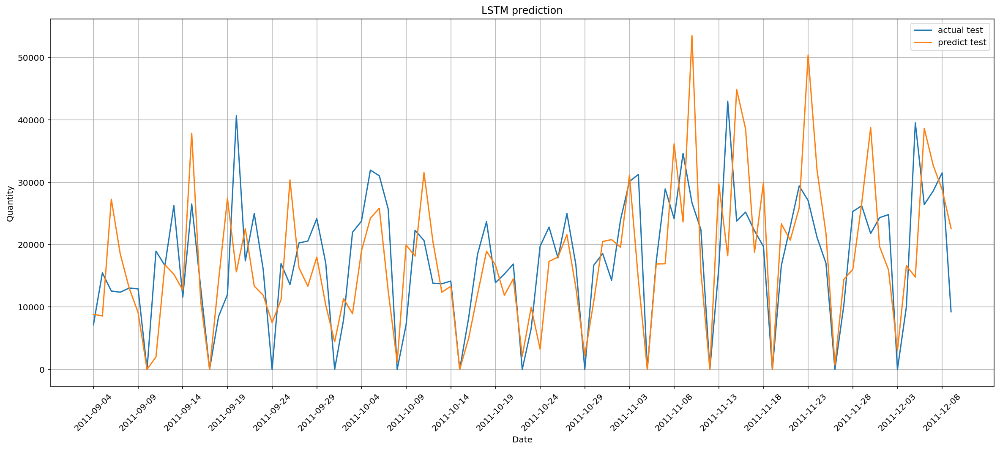

In [0]:
idx = df_all_days0[train_size+look_back:].index.to_list()
plt.figure(figsize=(20, 8))
plt.plot(idx, df_all_days0[train_size+look_back:], label = "actual test")
plt.plot(idx, testPredict_final, label = "predict test")
plt.legend()
plt.xticks(idx[::5], rotation = 45)
plt.grid()
plt.xlabel('Date')
plt.ylabel('Quantity')
plt.title("LSTM prediction")
plt.show()

**ОБЫЧНЫЕ РЯДЫ + LSTM + ПОДКРУЧЕННАЯ МОДЕЛЬ**

In [0]:
dataset = df_all_days0.values
dataset = np.reshape(dataset, (-1, 1))

In [0]:
# split into train and test sets
train_size = int(len(dataset) * 0.85)
test_size = len(dataset) - train_size
train, test = dataset[0:train_size,:], dataset[train_size:len(dataset),:]

scaler = StandardScaler()
train_scl = scaler.fit_transform(train)
test_scl = scaler.transform(test)

# reshape into X=t:t+14 and Y=t+15
look_back = 19
trainX, trainY = create_dataset(train_scl, look_back)
testX, testY = create_dataset(test_scl, look_back)
# reshape input to be [samples, time steps, features]
trainX = np.reshape(trainX, (trainX.shape[0], 1, trainX.shape[1]))
testX = np.reshape(testX, (testX.shape[0], 1, testX.shape[1]))

In [0]:
model = Sequential()
model.add(LSTM(150, input_shape=(1, look_back)))
model.add(Dense(300, activation='relu'))
model.add(Dropout(0.4))
model.add(Dense(1))
model.compile(loss='mean_squared_error', optimizer='adam')
model.fit(trainX, trainY, epochs=5000, batch_size=len(trainX), validation_data=(testX, testY), verbose=0)
# make predictions
trainPredict = model.predict(trainX)
testPredict = model.predict(testX)


In [0]:
testPredict_final = scaler.inverse_transform(testPredict)
testPredict_final[testPredict_final < 0] = 0

In [0]:
print("Mean squared error", mean_squared_error(df_all_days0[train_size+look_back:], testPredict_final))
print("Mean absolute error", mean_absolute_error(df_all_days0[train_size+look_back:], testPredict_final))
print("WAPE", wape(df_all_days0[train_size+look_back:], testPredict_final))

Mean squared error 87973536.91198027
Mean absolute error 7070.456885130509
WAPE Quantity    39.458642
dtype: float64


**СЕЗОННОСТЬ И ТРЕНД ИЗ МЕТОДА ХОЛЬТА-УИНТЕРСА + LSTM**



In [0]:
df_all_days0_deseas = df_all_days0.copy()
df_all_days0_deseas['Quantity'] = df_all_days0_deseas['Quantity'] - seas_holt - trend_holt

In [0]:
dataset = df_all_days0_deseas.values
dataset = np.reshape(dataset, (-1, 1))

In [0]:
# split into train and test sets
train_size = int(len(dataset) * 0.85)
test_size = len(dataset) - train_size
train, test = dataset[0:train_size,:], dataset[train_size:len(dataset),:]

scaler = StandardScaler()
train_scl = scaler.fit_transform(train)
test_scl = scaler.transform(test)

# reshape into X=t:t+16 and Y=t+17
look_back = 14
seasonal_coeff_test = seas_holt[train_size+look_back:len(dataset)]
trend_coeff_test = trend_holt[train_size+look_back:len(dataset)]
trainX, trainY = create_dataset(train_scl, look_back)
testX, testY = create_dataset(test_scl, look_back)
# reshape input to be [samples, time steps, features]
trainX = np.reshape(trainX, (trainX.shape[0], 1, trainX.shape[1]))
testX = np.reshape(testX, (testX.shape[0], 1, testX.shape[1]))

In [0]:
model = Sequential()
model.add(LSTM(200, input_shape=(1, look_back)))
model.add(Dense(400, activation='relu'))
model.add(Dropout(0.4))
model.add(Dense(1))
model.compile(loss='mean_squared_error', optimizer='adam')
model.fit(trainX, trainY, epochs=5000, batch_size=len(trainX), validation_data=(testX, testY), verbose=0)
# make predictions
trainPredict = model.predict(trainX)
testPredict = model.predict(testX)

In [0]:
testPredict_final = scaler.inverse_transform(testPredict)
testPredict_final = testPredict_final + np.array(seasonal_coeff_test).reshape(len(seasonal_coeff_test), 1)
testPredict_final = testPredict_final + np.array(trend_coeff_test).reshape(len(trend_coeff_test), 1)

In [0]:
testPredict_final[testPredict_final < 0] = 0

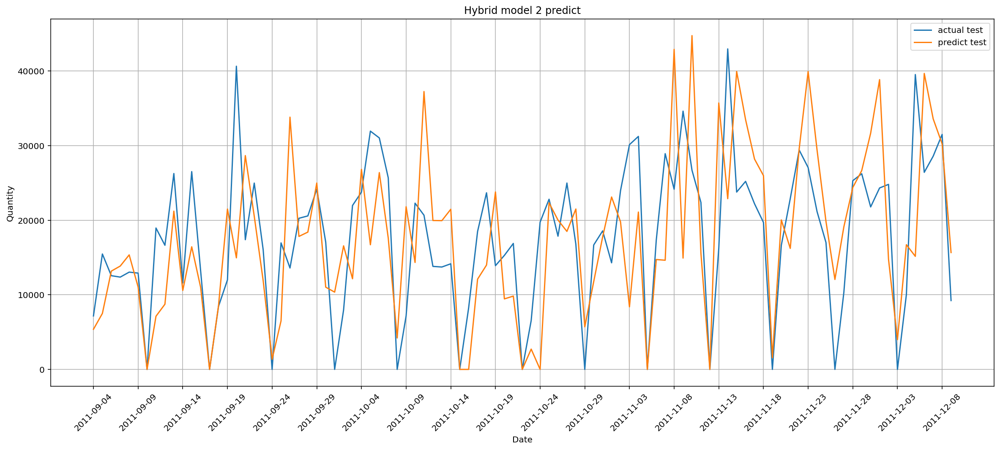

In [0]:
idx = df_all_days0[train_size+look_back:].index.to_list()
plt.figure(figsize=(20, 8))
plt.plot(idx, df_all_days0[train_size+look_back:], label = "actual test")
plt.plot(idx, testPredict_final, label = "predict test")
plt.legend()
plt.xticks(idx[::5], rotation = 45)
plt.grid()
plt.xlabel('Date')
plt.ylabel('Quantity')
plt.title("Hybrid model 2 predict")
plt.show()

In [0]:
print("Mean squared error", mean_squared_error(df_all_days0[train_size+look_back:], testPredict_final))
print("Mean absolute error", mean_absolute_error(df_all_days0[train_size+look_back:], testPredict_final))
print("WAPE", wape(df_all_days0[train_size+look_back:], testPredict_final))

Mean squared error 94066639.9674629
Mean absolute error 7484.799282658683
WAPE Quantity    42.479494
dtype: float64


**СЕЗОННОСТЬ МЕТОДОМ ХОЛЬТА УИНТЕРСА**

In [0]:
df_all_days0_deseas = df_all_days0.copy()
df_all_days0_deseas['Quantity'] = df_all_days0_deseas['Quantity'] - seas_holt

In [0]:
dataset = df_all_days0_deseas.values
dataset = np.reshape(dataset, (-1, 1))

In [0]:
# split into train and test sets
train_size = int(len(dataset) * 0.85)
test_size = len(dataset) - train_size
train, test = dataset[0:train_size,:], dataset[train_size:len(dataset),:]

scaler = StandardScaler()
train_scl = scaler.fit_transform(train)
test_scl = scaler.transform(test)

# reshape into X=t:t+16 and Y=t+17
look_back = 14
seasonal_coeff_test = seas_holt[train_size+look_back:len(dataset)]
trend_coeff_test = trend_holt[train_size+look_back:len(dataset)]
trainX, trainY = create_dataset(train_scl, look_back)
testX, testY = create_dataset(test_scl, look_back)
# reshape input to be [samples, time steps, features]
trainX = np.reshape(trainX, (trainX.shape[0], 1, trainX.shape[1]))
testX = np.reshape(testX, (testX.shape[0], 1, testX.shape[1]))

In [0]:
model = Sequential()
model.add(LSTM(150, input_shape=(1, look_back)))
model.add(Dense(300, activation='relu'))
model.add(Dropout(0.4))
model.add(Dense(1))
model.compile(loss='mean_squared_error', optimizer='adam')
model.fit(trainX, trainY, epochs=5000, batch_size=len(trainX), validation_data=(testX, testY), verbose=0)
# make predictions
trainPredict = model.predict(trainX)
testPredict = model.predict(testX)

In [0]:
testPredict_final = scaler.inverse_transform(testPredict)
testPredict_final = testPredict_final + np.array(seasonal_coeff_test).reshape(len(seasonal_coeff_test), 1)
testPredict_final[testPredict_final < 0] = 0


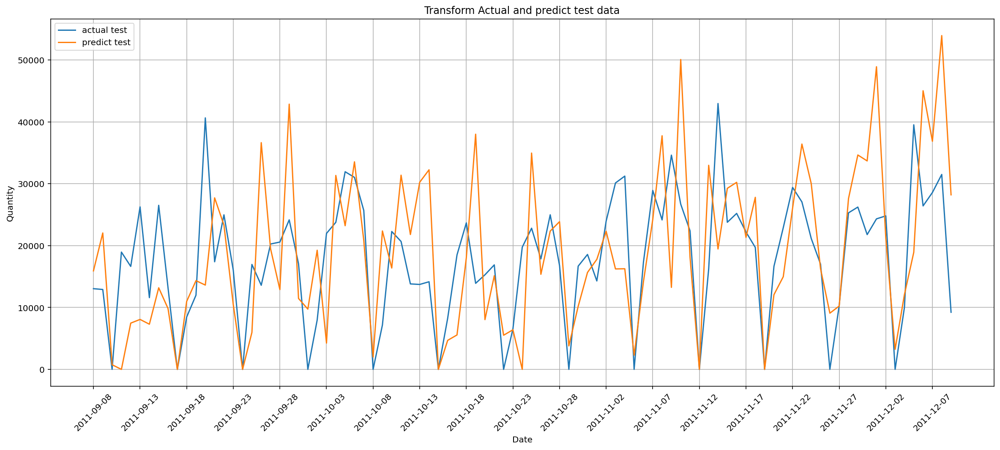

In [0]:
idx = df_all_days0[train_size+look_back:].index.to_list()
plt.figure(figsize=(20, 8))
plt.plot(idx, df_all_days0[train_size+look_back:], label = "actual test")
plt.plot(idx, testPredict_final, label = "predict test")
plt.legend()
plt.xticks(idx[::5], rotation = 45)
plt.grid()
plt.xlabel('Date')
plt.ylabel('Quantity')
plt.title("Transform Actual and predict test data")
plt.show()

In [0]:
print("Mean squared error", mean_squared_error(df_all_days0[train_size+look_back:], testPredict_final))
print("Mean absolute error", mean_absolute_error(df_all_days0[train_size+look_back:], testPredict_final))
print("WAPE", wape(df_all_days0[train_size+look_back:], testPredict_final))

Mean squared error 127577177.26817697
Mean absolute error 8695.153035496709
WAPE Quantity    48.668249
dtype: float64


**STACKED LSTM**

In [0]:


model = Sequential()
model.add(LSTM(50, activation='relu', return_sequences=True, input_shape=(n_steps, n_features)))
model.add(LSTM(50, activation='relu'))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')